In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

#import numpy as np # linear algebra
#import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
#for dirname, _, filenames in os.walk('/kaggle/input'):
 #   for filename in filenames:
  #      print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import os
import glob
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import random

from PIL import Image
import cv2

In [3]:
metadata_path = os.path.join('/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_metadata.csv')
metadata = pd.read_csv(metadata_path)
metadata.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear


In [4]:
metadata.shape

(10015, 7)

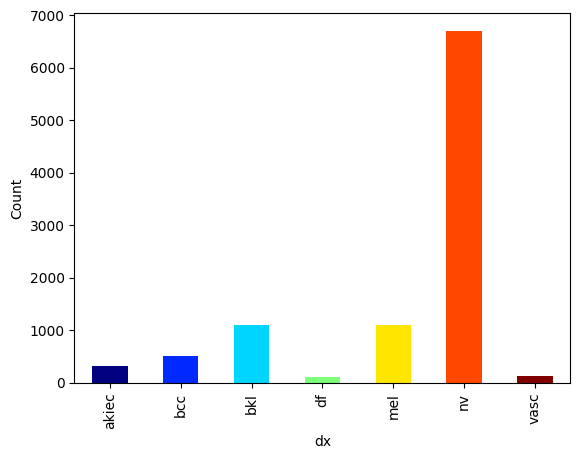

In [5]:
count = metadata.dx.value_counts().sort_index()

unique_vals = count.index
colors = plt.cm.jet(np.linspace(0, 1, len(unique_vals)))

count.plot(kind='bar', color=colors)

plt.ylabel('Count')
plt.show()

In [6]:
def check_for_missing_data(df):
    summary = pd.DataFrame(df.dtypes,columns=['dtypes'])
    summary = summary.reset_index()
    summary['Name'] = summary['index']
    summary = summary[['Name','dtypes']]
    summary['Missing'] = df.isnull().sum().values
    return summary

check_for_missing_data(metadata)

,Name,dtypes,Missing
0,lesion_id,object,0
1,image_id,object,0
2,dx,object,0
3,dx_type,object,0
4,age,float64,57
5,sex,object,0
6,localization,object,0


In [7]:
metadata.fillna({'age': metadata['age'].mean()}, inplace=True)


In [8]:
def convert_float_to_int(df, column_name):
    if df[column_name].dtype == 'float64':
        df[column_name] = df[column_name].astype(int)
    return df

metadata = convert_float_to_int(metadata,'age')
metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10015 entries, 0 to 10014
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   lesion_id     10015 non-null  object
 1   image_id      10015 non-null  object
 2   dx            10015 non-null  object
 3   dx_type       10015 non-null  object
 4   age           10015 non-null  int64 
 5   sex           10015 non-null  object
 6   localization  10015 non-null  object
dtypes: int64(1), object(6)
memory usage: 547.8+ KB


Remove the duplicates uf there are any

In [9]:
def check_for_duplicate_rows(df):
    size = df.shape
    sum_duplicates = df.duplicated().sum()
    sum_null = df.isnull().sum()
    return print("Number of Samples:" ,size[0],"\nDuplicated Entries: " ,sum_duplicates,"\nNull Entries:","\n",sum_null)

check_for_duplicate_rows(metadata)

Number of Samples: 10015 
Duplicated Entries:  0 
Null Entries: 
 lesion_id       0
image_id        0
dx              0
dx_type         0
age             0
sex             0
localization    0
dtype: int64


In [10]:
lesion_id_cnt = metadata['lesion_id'].value_counts()
def check_duplicates_lesions(id):
    if lesion_id_cnt[id] > 1:
        return True
    else:
        return False

metadata['dup_les'] = metadata['lesion_id'].map(check_duplicates_lesions)

metadata['dup_les'].value_counts()

dup_les
False    5514
True     4501
Name: count, dtype: int64

In [11]:
metadata = metadata[metadata.dup_les == False]
metadata.shape

(5514, 8)

### Load the image paths

Create 2 paths from input. The images are separated in these paths, so if they do not exist in path 1 they probably exist in path 2. Scanning all the rows using the "dx" and the "image_id" columns we can add the image path in a separete column in the dataframe.

In [12]:
base1_path = '/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_1'
base2_path = '/kaggle/input/skin-cancer-mnist-ham10000/HAM10000_images_part_2'

image_paths = []

for index, row in metadata.iterrows():
    image_id = row['image_id']

    image_path_1 = os.path.join(base1_path, f'{image_id}.jpg')
    image_path_2 = os.path.join(base2_path, f'{image_id}.jpg')

    if os.path.exists(image_path_1):
        image_paths.append(image_path_1)
    elif os.path.exists(image_path_2):
        image_paths.append(image_path_2)
    else:
        print(f'Image {image_id} not found in either path.')

# Add the image paths to your DataFrame
metadata['image_path'] = image_paths

metadata.head()


,lesion_id,image_id,dx,dx_type,age,sex,localization,dup_les,image_path
10,HAM_0001396,ISIC_0025276,bkl,histo,55,female,trunk,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
15,HAM_0007207,ISIC_0031326,bkl,histo,65,male,back,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
20,HAM_0006071,ISIC_0032343,bkl,histo,70,female,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
33,HAM_0005612,ISIC_0024981,bkl,histo,80,male,scalp,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
34,HAM_0005388,ISIC_0027815,bkl,histo,80,male,chest,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...


In [13]:
metadata.shape

(5514, 9)

### Exploration

<Axes: ylabel='count'>

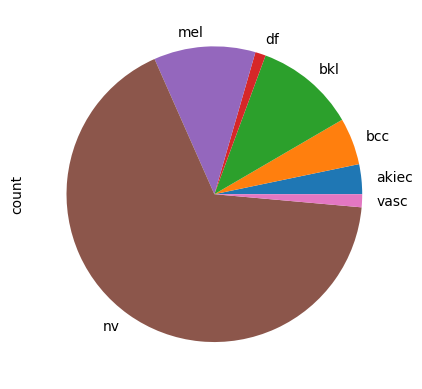

In [14]:
count.plot(kind='pie')

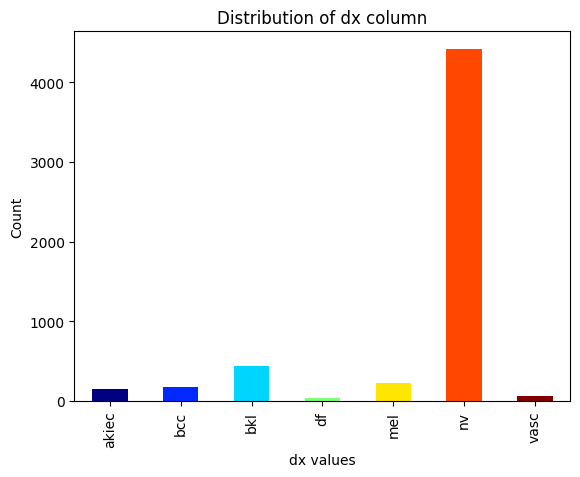

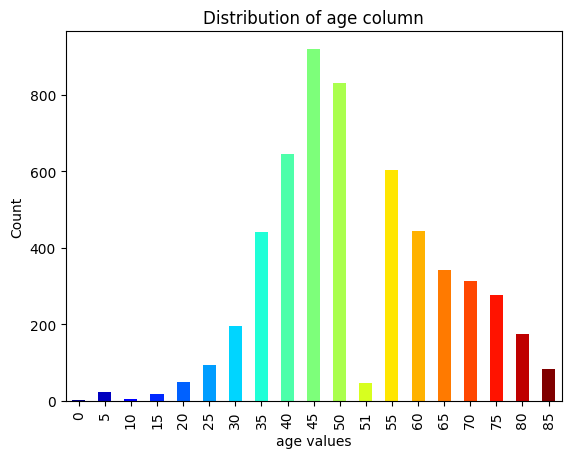

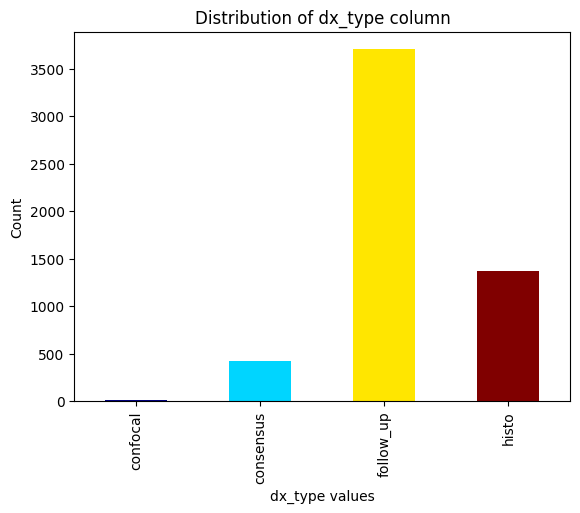

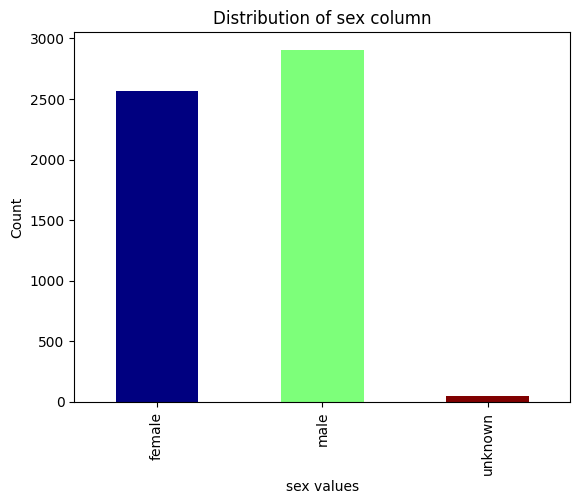

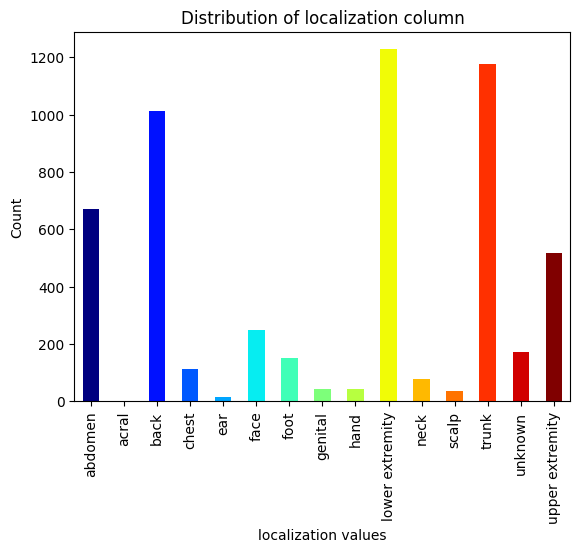

In [15]:
columns_exp = ['dx','age','dx_type', 'sex', 'localization']

for column in columns_exp:
  count = metadata[column].value_counts().sort_index()

  unique_vals = count.index
  colors = plt.cm.jet(np.linspace(0, 1, len(unique_vals)))

  count.plot(kind='bar', color=colors)

  plt.xlabel(f'{column} values')
  plt.ylabel('Count')
  plt.title(f'Distribution of {column} column')
  plt.show()

In [16]:
metadata.loc[metadata['sex']=='unknown'].shape

(45, 9)

In [17]:
metadata.loc[metadata['localization']=='unknown'].shape


(173, 9)

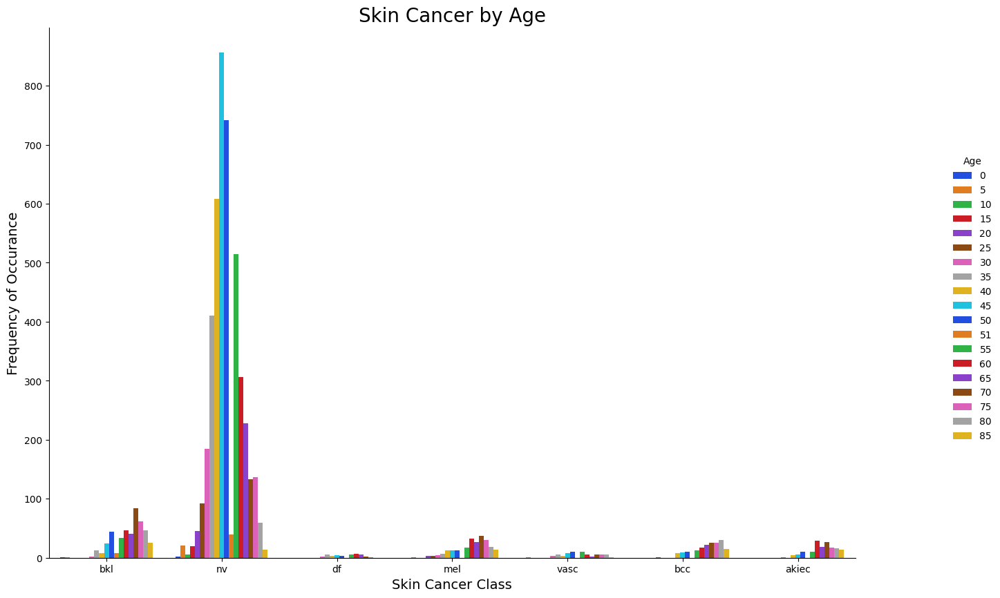

In [18]:
#Skin Cancer by age
g = sns.catplot(x="dx", kind="count", hue="age", palette='bright', data=metadata)
g.fig.set_size_inches(16, 9)

g.ax.set_title('Skin Cancer by Age', fontsize=20)
g.set_xlabels('Skin Cancer Class', fontsize=14)
g.set_ylabels('Frequency of Occurance', fontsize=14)
g._legend.set_title('Age')

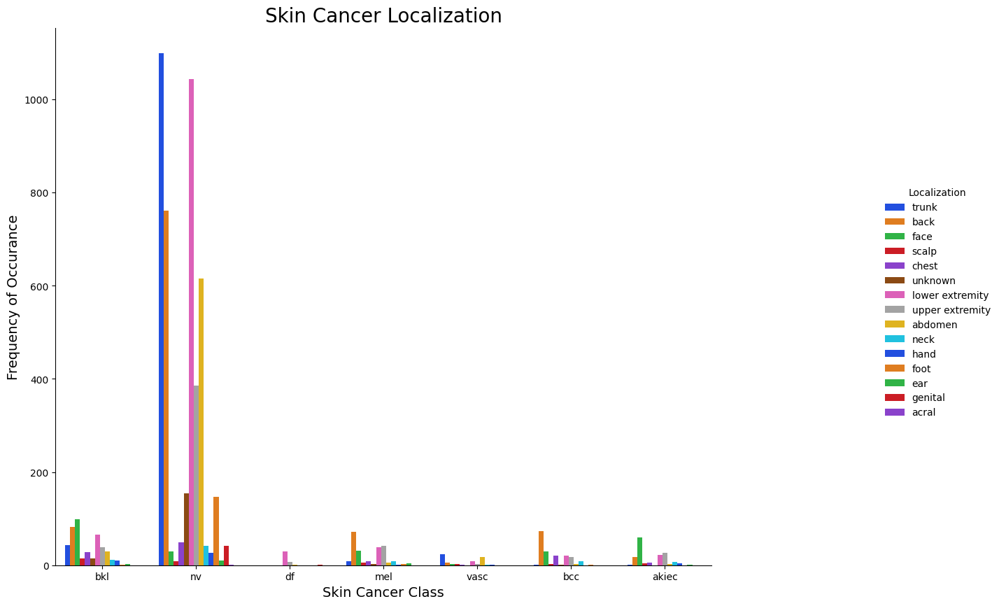

In [19]:
g = sns.catplot(x="dx", kind="count", hue="localization", palette='bright', data=metadata)
g.fig.set_size_inches(16, 9)

g.ax.set_title('Skin Cancer Localization', fontsize=20)
g.set_xlabels('Skin Cancer Class', fontsize=14)
g.set_ylabels('Frequency of Occurance', fontsize=14)
g._legend.set_title('Localization')

In [20]:
metadata.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dup_les,image_path
10,HAM_0001396,ISIC_0025276,bkl,histo,55,female,trunk,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
15,HAM_0007207,ISIC_0031326,bkl,histo,65,male,back,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
20,HAM_0006071,ISIC_0032343,bkl,histo,70,female,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
33,HAM_0005612,ISIC_0024981,bkl,histo,80,male,scalp,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...
34,HAM_0005388,ISIC_0027815,bkl,histo,80,male,chest,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...


### Plot images from each class and their color distributions

In [21]:
def pltImg(images, labels, row_num, col_num):
    fig, axes = plt.subplots(row_num, col_num, figsize=(15, 8))
    axes = axes.ravel()  # Flatten axes array

    for i, image in enumerate(images):
        axes[i].imshow(image)
        axes[i].axis('off')
        axes[i].set_title(f"Class: {labels[i]}\nMean intensity: {np.mean(image):.1f}")

    plt.tight_layout()
    plt.show()


def pltHist(images, labels, row_num, col_num):
    fig, axes = plt.subplots(row_num, col_num, figsize=(15, 8))
    axes = axes.ravel()  # Flatten axes array
    colors = ["red", "green", "blue"]

    for i, image in enumerate(images):
        image_array = np.array(image)

        # Plotting all channels with colors
        for channel in range(3):
            hist, bin_edges = np.histogram(image_array[:, :, channel], bins=256, range=(0, 256))
            axes[i].plot(bin_edges[:-1], hist, color=colors[channel])

        axes[i].set_title(f"Class: {labels[i]}")

    plt.tight_layout()
    plt.show()

In [22]:
def randImg(df, label, seed, sample_size):
    # Filter dataframe for specific label/class
    df_class = df[df['dx'] == label]

    # Randomly sample images from this class
    random.seed(seed)
    sample_df = df_class.sample(n=sample_size)

    images = []
    labels = []
    for index, row in sample_df.iterrows():
        image_path = row['image_path']
        if os.path.exists(image_path):
            image = Image.open(image_path)
            images.append(image)
            labels.append(label)
        else:
            print(f"Image not found: {image_path}")

    return images, labels


--- Showcasing examples for class: bkl ---



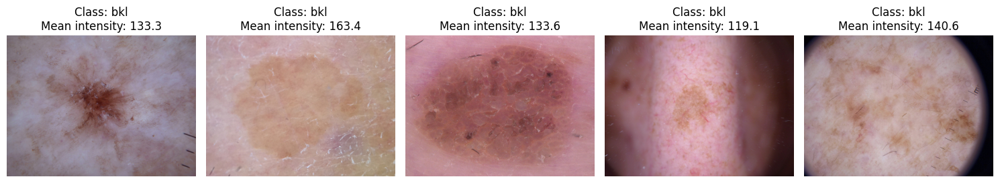

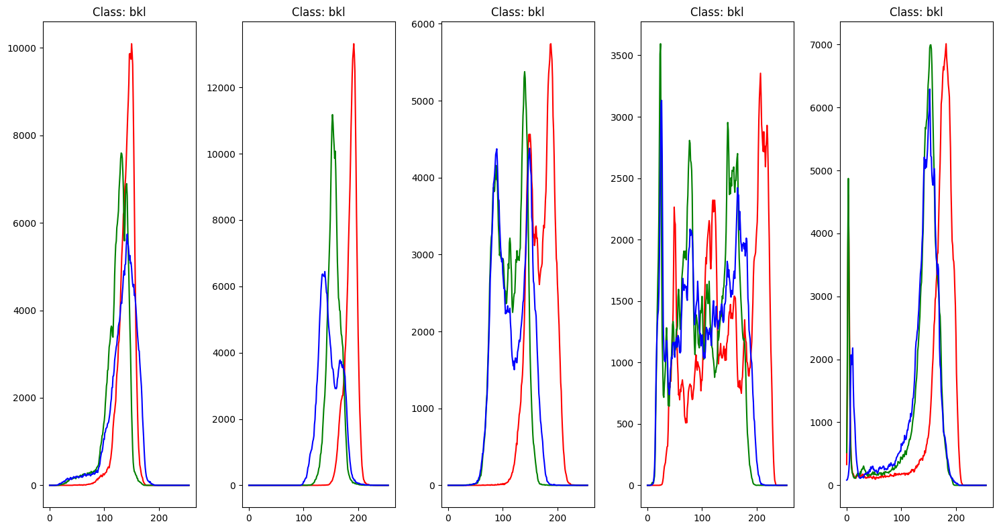


--- Showcasing examples for class: nv ---



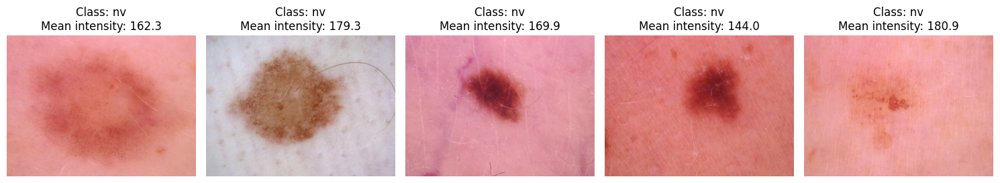

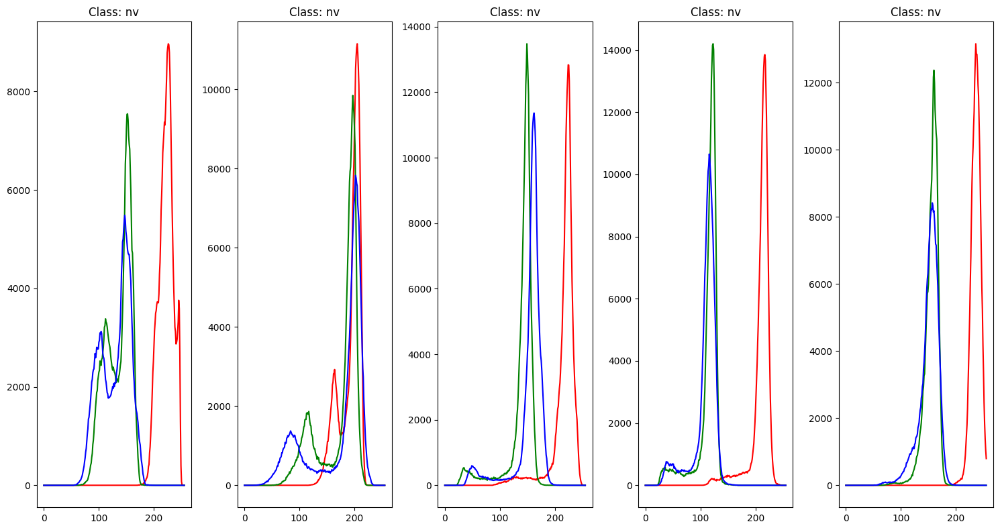


--- Showcasing examples for class: df ---



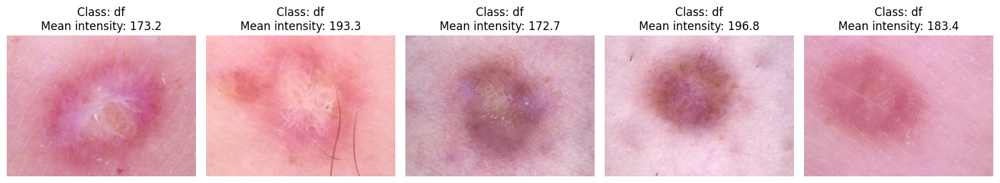

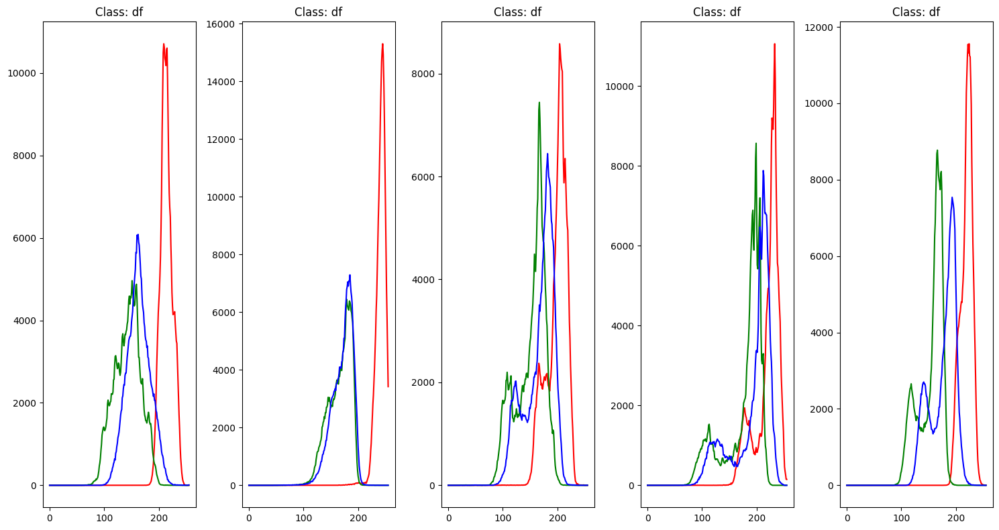


--- Showcasing examples for class: mel ---



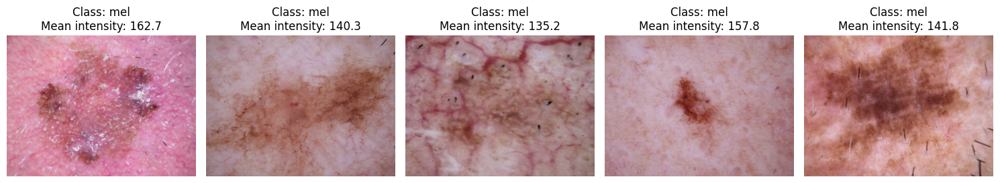

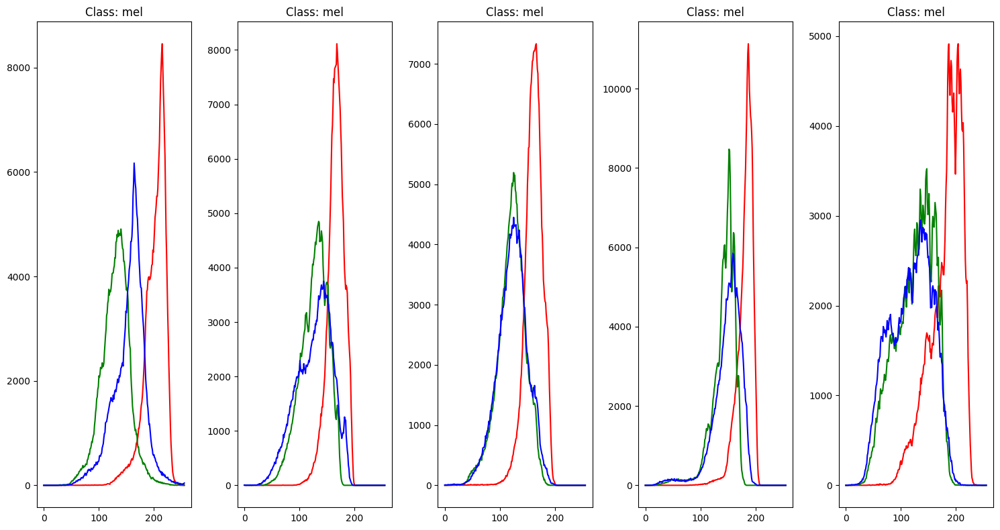


--- Showcasing examples for class: vasc ---



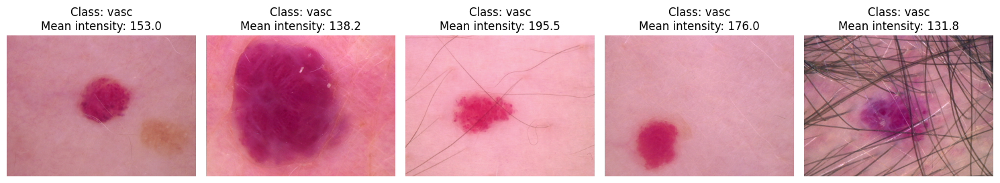

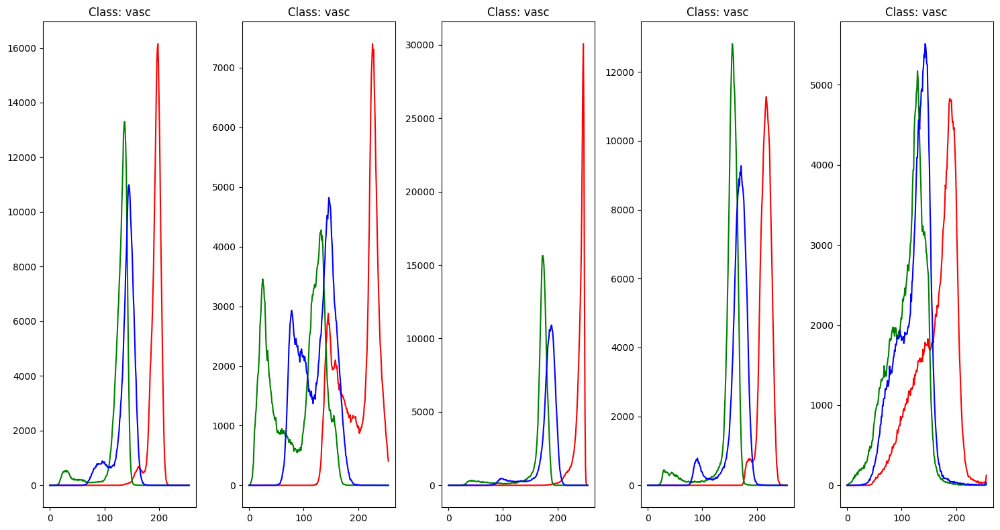


--- Showcasing examples for class: bcc ---



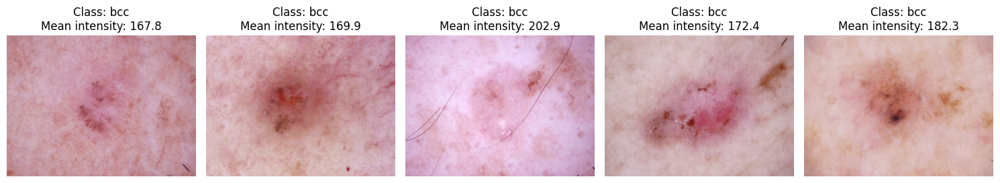

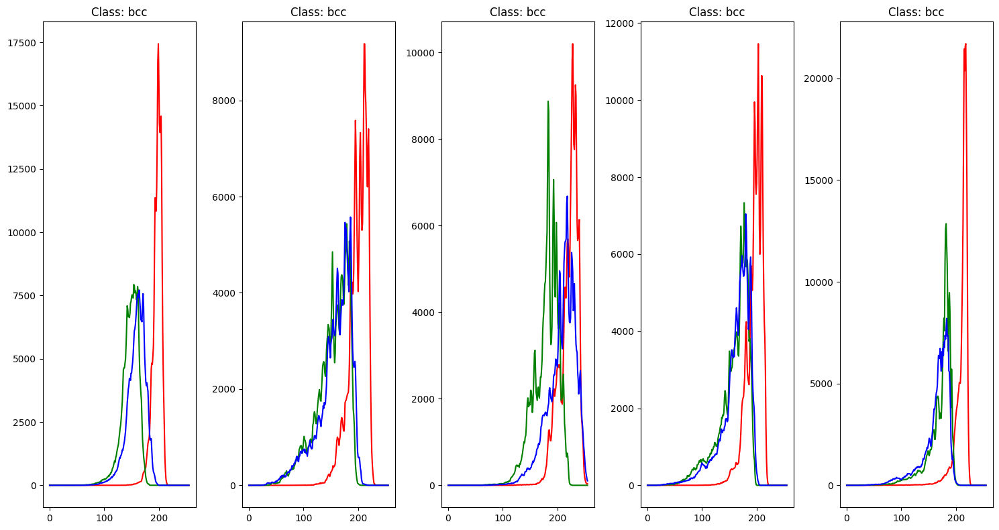


--- Showcasing examples for class: akiec ---



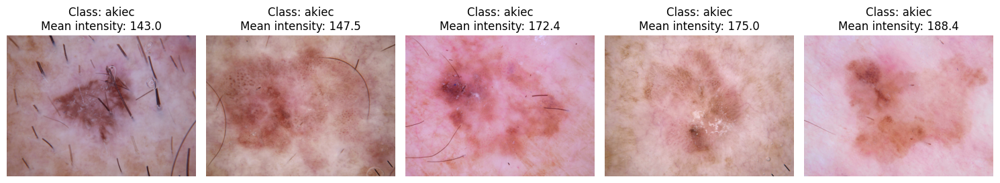

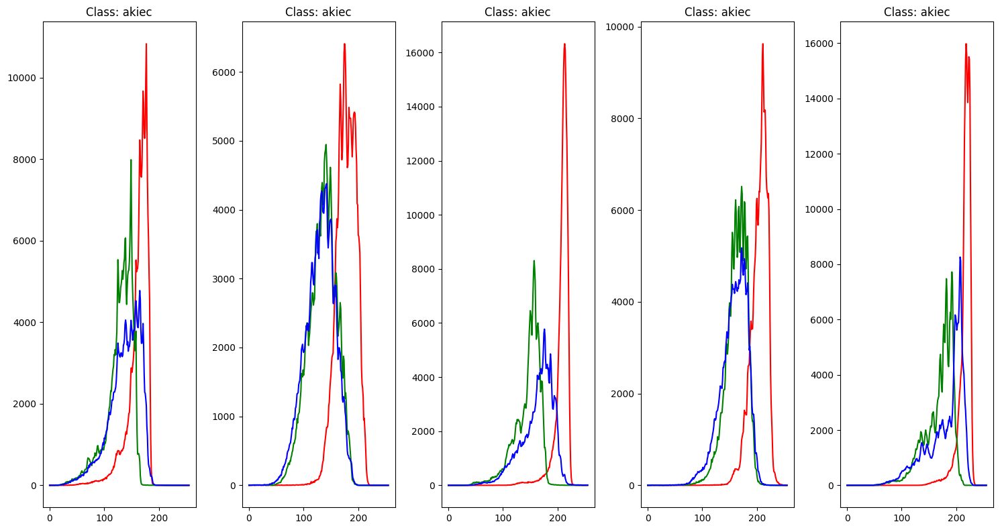

In [23]:
class_labels = ['bkl', 'nv', 'df', 'mel', 'vasc', 'bcc', 'akiec']

for class_label in class_labels:
    print(f"\n--- Showcasing examples for class: {class_label} ---\n")
    images, labels = randImg(df=metadata, label=class_label, seed=42, sample_size=5)

    # For displaying images
    pltImg(images, labels, 1, 5)
    # pltImgEq(images, labels, 1, 5)
    # For displaying histograms
    pltHist(images, labels, 1, 5)

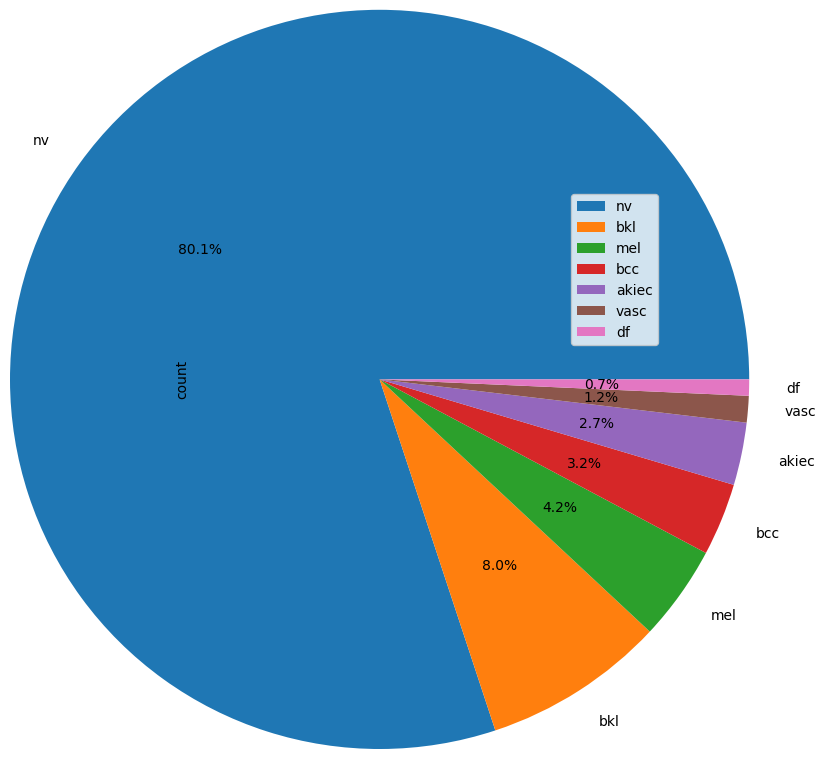

In [24]:
count = metadata['dx'].value_counts()
ax = count.plot(kind="pie", autopct='%1.1f%%', legend=True,radius=2.5)
ax.legend(bbox_to_anchor=(1, 1.02), loc='upper left')
plt.show()

In [25]:
count

dx
nv       4415
bkl       440
mel       230
bcc       175
akiec     151
vasc       64
df         39
Name: count, dtype: int64

LABELS :

Melanocytic nevi (nv) -
Melanocytic nevi are benign neoplasms of melanocytes and appear in a myriad of variants, which all are included in our series. The variants may differ significantly from a dermatoscopic point of view.

[4415 images]

Melanoma (mel) -
Melanoma is a malignant neoplasm derived from melanocytes that may appear in different variants. If excised in an early stage it can be cured by simple surgical excision. Melanomas can be invasive or non-invasive (in situ). We included all variants of melanoma including melanoma in situ, but did exclude non-pigmented, subungual, ocular or mucosal melanoma.

[230 images]

Benign keratosis-like lesions (bkl) -
"Benign keratosis" is a generic class that includes seborrheic ker- atoses ("senile wart"), solar lentigo - which can be regarded a flat variant of seborrheic keratosis - and lichen-planus like keratoses (LPLK), which corresponds to a seborrheic keratosis or a solar lentigo with inflammation and regression [22]. The three subgroups may look different dermatoscop- ically, but we grouped them together because they are similar biologically and often reported under the same generic term histopathologically. From a dermatoscopic view, lichen planus-like keratoses are especially challeng- ing because they can show morphologic features mimicking melanoma [23] and are often biopsied or excised for diagnostic reasons.

[440 images]

Basal cell carcinoma (bcc) -
Basal cell carcinoma is a common variant of epithelial skin cancer that rarely metastasizes but grows destructively if untreated. It appears in different morphologic variants (flat, nodular, pigmented, cystic, etc) [21], which are all included in this set.

[175 images]

Actinic keratoses (akiec) -
Actinic Keratoses (Solar Keratoses) and intraepithelial Carcinoma (Bowen’s disease) are common non-invasive, variants of squamous cell car- cinoma that can be treated locally without surgery. Some authors regard them as precursors of squamous cell carcinomas and not as actual carci- nomas. There is, however, agreement that these lesions may progress to invasive squamous cell carcinoma - which is usually not pigmented. Both neoplasms commonly show surface scaling and commonly are devoid of pigment. Actinic keratoses are more common on the face and Bowen’s disease is more common on other body sites. Because both types are in- duced by UV-light the surrounding skin is usually typified by severe sun damaged except in cases of Bowen’s disease that are caused by human papilloma virus infection and not by UV. Pigmented variants exists for Bowen’s disease [19] and for actinic keratoses [20]. Both are included in this set.

[151 images]

Vascular lesions (vasc) -
Vascular skin lesions in the dataset range from cherry angiomas to angiokeratomas [25] and pyogenic granulomas [26]. Hemorrhage is also included in this category.

[64 images]

Dermatofibrom (df) -
Dermatofibroma is a benign skin lesion regarded as either a benign proliferation or an inflammatory reaction to minimal trauma. It is brown often showing a central zone of fibrosis dermatoscopically [24].

[39 images]

[Total images = 5514]

### Data Augmentation

In [26]:
metadata.dx.unique()

array(['bkl', 'nv', 'df', 'mel', 'vasc', 'bcc', 'akiec'], dtype=object)

In [27]:
count = metadata['dx'].value_counts().sort_index()
count

dx
akiec     151
bcc       175
bkl       440
df         39
mel       230
nv       4415
vasc       64
Name: count, dtype: int64

<Axes: ylabel='count'>

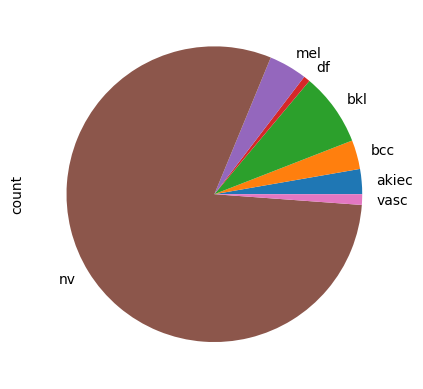

In [28]:
count.plot(kind='pie')

From this pie plot, we can see the huge imbalance between classes.

In [29]:
def data_aug(df, col_name, val_name, class_max):
  ''' This function balances the classes by 2 using the overrepresentation of the minor class'''
  given_cols = df[df[col_name].isin([val_name, class_max])]
  class_counts = df[col_name].value_counts()
  class_count_max = class_counts[class_max]
  class_count_val = class_counts[val_name]
  max_class = given_cols[given_cols[col_name]==class_max]
  val_class = given_cols[given_cols[col_name]==val_name]
  val_class_over = val_class.sample(class_count_max,replace= True)
  df = df[df[col_name] != val_name]
  df = pd.concat([df,val_class_over],axis=0)
  return df

In [30]:
class_max = count.idxmax()

for val_name in metadata.dx.unique():
  if val_name != class_max:
    metadata = data_aug(metadata,'dx',val_name,class_max)

metadata.shape

(30905, 9)

<Axes: ylabel='count'>

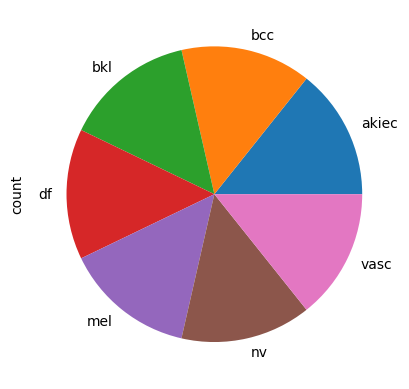

In [31]:
count = metadata['dx'].value_counts().sort_index()
count.plot(kind='pie')

### Data Export

For metadata['dx']:

'bkl': 0, 'nv': 1, 'df': 2, 'mel': 3, 'vasc': 4, 'bcc': 5, 'akiec': 6

In [32]:
enum_labels = {'bkl': 0, 'nv': 1, 'df': 2, 'mel': 3, 'vasc': 4, 'bcc': 5, 'akiec': 6}

metadata['dx_cat'] = metadata['dx'].map(enum_labels)

In [33]:
metadata.dx_cat.unique()

array([1, 0, 2, 3, 4, 5, 6])

In [34]:
metadata.to_csv('/kaggle/working/data_enum.csv', index=False)


The new file `data_enum.csv` it was created and saved in `Output` (working) directory. This directory is writable and is the default working directory in a Kaggle notebook.

______

# CNN model

In [35]:
!pip install torchsummary
!pip install Dataloaders

In [36]:
from tqdm import tqdm

from skimage import io, transform
from sklearn.model_selection import train_test_split
from sklearn.metrics import  accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
import torch.optim as optim
from torch.autograd import Variable
import torchvision
from torchvision import models,transforms

#from Dataloaders.HAM10000Dataset import HAM10000Dataset
#from functions import normalization, Model_functions

import time

import random
from PIL import Image
import cv2
import gc
import optuna
import logging

______

## HAM10000Dataset

In [37]:
class HAM10000Dataset(Dataset):
    def __init__(self, data, label_column='dx_cat', img_col='image_path', transform=None):
        """
        Custom Dataset for loading HAM10000 images and labels.

        Args:
            data (pd.DataFrame): DataFrame containing image paths and labels.
            label_column (str): Name of the column containing labels.
            img_col (str): Name of the column containing image paths.
            transform (callable, optional): Optional transform to be applied on an image.
        """
        self.data = data.reset_index(drop=True)
        self.label_column = label_column
        self.img_col = img_col
        self.transform = transform

    def __len__(self):
        """Returns the total number of samples."""
        return len(self.data)

    def __getitem__(self, idx):
        """Generates one sample of data."""
        # Get image path
        image_path = self.data.at[idx, self.img_col]

        # Open image
        image = Image.open(image_path).convert('RGB')

        # Get label
        label = self.data.at[idx, self.label_column]
        label = torch.tensor(label, dtype=torch.long)

        # Apply transformations
        if self.transform:
            image = self.transform(image)

        return image, label

### Model Functions

In [38]:
def train_epoch(model, train_loader, criterion, optimizer, device):
    model.train()
    train_loss = 0.0
    correct = 0
    total = 0

    for data, labels in train_loader:
        data, labels = data.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(data)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    avg_train_loss = train_loss / len(train_loader)
    train_accuracy = 100 * correct / total
    return avg_train_loss, train_accuracy

def validate_epoch(model, val_loader, criterion, device):
    model.eval()
    valid_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for data, labels in val_loader:
            data, labels = data.to(device), labels.to(device)
            outputs = model(data)
            loss = criterion(outputs, labels)

            valid_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    avg_valid_loss = valid_loss / len(val_loader)
    valid_accuracy = 100 * correct / total
    return avg_valid_loss, valid_accuracy

def test_model(model, test_loader, device):
    model.eval()
    correct = 0
    total = 0

    with torch.no_grad():
        for data, labels in test_loader:
            data, labels = data.to(device), labels.to(device)
            outputs = model(data)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    test_accuracy = 100 * correct / total
    return test_accuracy

def train_and_validate_model(model, train_loader, val_loader, test_loader, criterion, patience, optimizer, device, epochs, model_filename, verbose=False):
    min_valid_loss = np.inf

    total_loss_train = []
    total_loss_val = []
    total_acc_train = []
    total_acc_val = []
    stopping_ct = 0

    for epoch in tqdm(range(epochs)):
        if stopping_ct < patience:            
            train_loss, train_acc = train_epoch(model, train_loader, criterion, optimizer, device)
            valid_loss, valid_acc = validate_epoch(model, val_loader, criterion, device)

            total_loss_train.append(train_loss)
            total_loss_val.append(valid_loss)
            total_acc_train.append(train_acc)
            total_acc_val.append(valid_acc)
            if verbose:
                print(f'Epoch {epoch+1}')
                print(f'Training Loss: {train_loss} \nTraining Accuracy: {train_acc}%')
                print(f'Validation Loss: {valid_loss} \nValidation Accuracy: {valid_acc}%')
                print('=======================================================================')
        if min_valid_loss > valid_loss:
            print(f'Validation Loss Decreased({min_valid_loss:.6f}--->{valid_loss:.6f}) \nSaving The Model')
            print('=======================================================================')
            min_valid_loss = valid_loss
            torch.save(model.state_dict(), model_filename)
            stopping_ct = 0
        else:
            stopping_ct += 1

    best_model_state = torch.load(model_filename)
    model.load_state_dict(best_model_state)
    return model,total_loss_train, total_loss_val, total_acc_train, total_acc_val


def set_parameter_requires_grad(model, feature_extracting):
    if feature_extracting:
        for param in model.parameters():
            param.requires_grad = False


def initialise_model(model_name, num_classes, feature_extract, use_pretrained=True):
    '''
    grad = if the pretrained weights be updated
    use_pretrained = use pre trained weights or start from scratch
    '''
    model = None
    
    if model_name == 'resnet_pret':
        model_ft = models.resnet50(pretrained=use_pretrained)
        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.fc.in_features
        model_ft.fc = nn.Linear(num_ftrs, num_classes)
    elif model_name == 'densenet_pret':
        model_ft = models.densenet121(pretrained=use_pretrained)
        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.classifier.in_features
        model_ft.classifier = nn.Linear(num_ftrs, num_classes)
    else:
        print("Invalid model name, choose between 'resnet_pret', 'densenet_pret'.")
        exit()
    return model_ft


def conf_report(model_fitted,loader, model_type):
    """
    Generate and display a confusion matrix and a classification report for the predictions made by a model.

    Parameters:
    - model_fitted: The trained model that will be used to make predictions. The model should be compatible
                    with the data provided by the loader and should have a `to` method for device management
                    and an `argmax` method for getting predictions.
    - loader: A data loader that provides batches of data. Each batch should be a tuple containing data
              and its corresponding labels. The loader should be iterable.
    - model_type: A string indicating the type of the model. This is used for labeling purposes
                  when saving the confusion matrix figure.

    The function does the following:
    - Iterates over the provided data loader to collect model predictions and true labels.
    - Computes a confusion matrix both in raw and normalized form.
    - Displays heatmaps for both raw and normalized confusion matrices.
    - Prints a classification report showing main classification metrics.

    Outputs:
    - A figure with two subplots: the left one showing the normalized confusion matrix and the right
      one showing the raw confusion matrix. The figure is saved as 'Confusion_Matrix_{model_type}.png'.
    - A printed classification report in the console.
    """
    y_pred = []
    y_true = []
    for data, target in loader:
        data, target = data.to('cpu'), target.to('cpu')
        model_cpu = model_fitted.to('cpu')
        output = model_cpu(data)
        y_pred.extend(output.argmax(dim=1).tolist())
        y_true.extend(target.tolist())
    
    classes = [ 'bkl','nv','df','mel','vasc','bcc','akiec']

    cf_matrix = confusion_matrix(y_true, y_pred)
    df_temp = pd.DataFrame(cf_matrix / np.sum(cf_matrix, axis=1)[:, np.newaxis], index=classes, columns=classes)

    plt.figure(figsize=(24, 10))  

    plt.subplot(1, 2, 1)  
    sns.heatmap(df_temp, annot=True, fmt=".3f", cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title('Normalized Confusion Matrix')
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')

    plt.subplot(1, 2, 2)  
    sns.heatmap(cf_matrix, annot=True, fmt='g', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title('Raw Confusion Matrix')
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')

    plt.savefig(f'Confusion_Matrix_{model_type}.png')
    plt.show()

    report = classification_report(y_true, y_pred, target_names=classes)
    print('-------------------------------------------------------')
    print("Classification Report:\n")
    print(report)
    print('-------------------------------------------------------')

_____

In [39]:
data = pd.read_csv('/kaggle/working/data_enum.csv')
data = data.sample(frac=1)
data.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dup_les,image_path,dx_cat
16636,HAM_0004476,ISIC_0030417,mel,histo,70,male,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,3
2464,HAM_0006890,ISIC_0031983,nv,follow_up,60,male,lower extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,1
20055,HAM_0002177,ISIC_0025612,vasc,consensus,45,female,neck,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,4
18498,HAM_0001091,ISIC_0031955,vasc,consensus,30,female,lower extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,4
17202,HAM_0005555,ISIC_0032079,mel,histo,60,female,chest,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,3


## Preprocessing

### Normalize function

In [40]:
img_h, img_w = 224, 224

norm_means = [0.77148203, 0.55764165, 0.58345652]
norm_std = [0.12655577, 0.14245141, 0.15189891]

### Data Augmentation and normalization

In this section, we define the transformations to be applied to the training, validation, and test images. These transformations help in augmenting the dataset and normalizing the images for better model performance.

In [ ]:
# define the transformation of the train images.
transform = transforms.Compose([
    transforms.Resize((img_h,img_w)),  # Resize images to the specified height and width
    transforms.RandomHorizontalFlip(), # Randomly flip images horizontally
    transforms.RandomVerticalFlip(), # Randomly flip images vertically
    transforms.RandomRotation(20), # Randomly rotate images by up to 20 degrees
    transforms.ColorJitter(brightness=0.1, contrast=0.1, hue=0.1), # Randomly change brightness, contrast, and hue
    transforms.ToTensor(), # Convert images to PyTorch tensors
    transforms.Normalize(norm_means, norm_std)]) # Normalize images using the specified mean and standard deviation

# define the transformation of the val and test images.
val_test_transform = transforms.Compose([
    transforms.Resize((img_h,img_w)), # Resize images to the specified height and width
    transforms.ToTensor(), # Convert images to PyTorch tensors
    transforms.Normalize(norm_means, norm_std)]) # Normalize images using the specified mean and standard deviation

The training transformations include various data augmentation techniques such as flipping, rotation, and color jittering to make the model more robust to variations in the input data. The validation and test transformations only include resizing and normalization to ensure consistency during evaluation.


In [42]:
data.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dup_les,image_path,dx_cat
16636,HAM_0004476,ISIC_0030417,mel,histo,70,male,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,3
2464,HAM_0006890,ISIC_0031983,nv,follow_up,60,male,lower extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,1
20055,HAM_0002177,ISIC_0025612,vasc,consensus,45,female,neck,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,4
18498,HAM_0001091,ISIC_0031955,vasc,consensus,30,female,lower extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,4
17202,HAM_0005555,ISIC_0032079,mel,histo,60,female,chest,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,3


### Data Loading

In [43]:
train_val_data, test_data = train_test_split(data, test_size=0.2, random_state=42)

train_data, val_data = train_test_split(train_val_data, test_size=0.5, random_state=42)

train_dataset = HAM10000Dataset(train_data, transform=transform)
val_dataset = HAM10000Dataset(val_data, transform=transform)
test_dataset = HAM10000Dataset(test_data, transform=transform)

In [44]:
batch_size = 64
num_workers = 4

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)
val_loader = DataLoader(val_dataset, batch_size=batch_size, num_workers=num_workers)
test_loader = DataLoader(test_dataset, batch_size=batch_size, num_workers=num_workers)

print('Data len Train:', len(train_dataset), 'Val:', len(val_dataset), 'Test:', len(test_dataset))

Data len Train: 12362 Val: 12362 Test: 6181


### Batch check

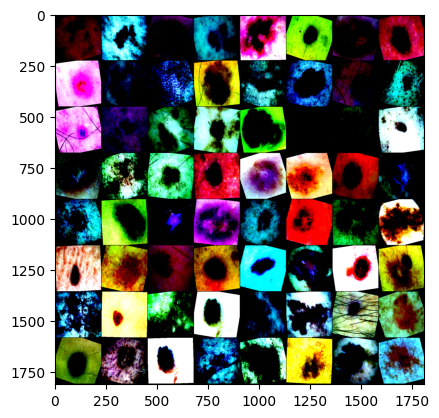

Labels:  tensor([0, 0, 1, 6, 2, 1, 2, 1, 1, 0, 6, 1, 5, 3, 1, 5, 4, 4, 6, 3, 3, 4, 4, 5,
        2, 6, 5, 4, 2, 1, 1, 1, 0, 0, 3, 2, 2, 2, 5, 3, 1, 0, 0, 1, 1, 3, 1, 2,
        0, 4, 5, 4, 0, 3, 4, 6, 1, 6, 4, 0, 6, 1, 3, 5])


In [45]:
def imshow(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

# Get a batch of training data
dataiter = iter(train_loader)
images, labels = next(dataiter)

imshow(torchvision.utils.make_grid(images))
print('Labels: ', labels) 

In [46]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f'Using device: {device}')

Using device: cuda


# Hyperparameter tuning

Balanced subsample split

In [47]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

selected_data = (
    data
    .groupby('dx', as_index=False)
    .apply(lambda x: x.sample(n=500))
    .reset_index(drop=True)
)
selected_data.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dup_les,image_path,dx_cat
0,HAM_0002699,ISIC_0029827,akiec,histo,60,male,back,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,6
1,HAM_0001786,ISIC_0027047,akiec,histo,70,male,upper extremity,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,6
2,HAM_0001625,ISIC_0028224,akiec,histo,40,female,chest,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,6
3,HAM_0004243,ISIC_0031119,akiec,histo,80,male,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,6
4,HAM_0001576,ISIC_0033705,akiec,histo,60,male,face,False,/kaggle/input/skin-cancer-mnist-ham10000/HAM10...,6


In [48]:
class CNNet_trial(nn.Module):
    def __init__(self, num_filters, num_classes, num_of_layers):
        super(CNNet_trial, self).__init__()
        
        self.layers = nn.ModuleList()
        in_channels = 3         
        for out_channels in num_filters:
            self.layers.append(nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(),
                nn.MaxPool2d(kernel_size=2, stride=2)
            ))
            in_channels = out_channels
        
        self.flat_features = int(num_filters[-1] * (224/2**num_of_layers) * (224/2**num_of_layers))
        self.fc1 = nn.Linear(self.flat_features, 512)
        self.fc2 = nn.Linear(512, 128)
        self.fc3 = nn.Linear(128, num_classes)

    def forward(self, x):
        for layer in self.layers:
            x = layer(x)
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

In [49]:
train_val_trial, test_trial = train_test_split(selected_data, test_size=0.2, random_state=42)

train_trial, val_trial = train_test_split(selected_data, test_size=0.5, random_state=42)

train_trial = HAM10000Dataset(train_trial, transform=transform)
val_trial = HAM10000Dataset(val_trial, transform=transform)
test_trial = HAM10000Dataset(test_trial, transform=transform)

batch_size = 64
num_workers = 4

train_loader_trial = DataLoader(train_trial, batch_size=batch_size, shuffle=True, num_workers=num_workers)
val_loader_trial = DataLoader(val_trial, batch_size=batch_size, num_workers=num_workers)
test_loader_trial = DataLoader(test_trial, batch_size=batch_size, num_workers=num_workers)

print('Data len Train:', len(train_trial), 'Val:', len(val_trial), 'Test:', len(test_trial))

Data len Train: 1750 Val: 1750 Test: 700


### Set the optuna parameters

In [50]:
optuna.logging.set_verbosity(optuna.logging.WARNING)

def objective(trial):
    
    seed = 42
    torch.manual_seed(seed)
    random.seed(seed)
    
    num_of_layers = trial.suggest_int('num_of_layers', 3, 4)
    
    if num_of_layers == 4:
        num_filters_choices = [
            (16, 32, 64, 128),
            (32, 64, 128, 256),
            (64, 128, 256, 512),
            (16, 32, 128, 512),
            (32, 32, 64, 256),
            (32, 128, 256, 256),
            (32, 128, 128, 256),
            (128, 256, 512, 512)
        ]
        num_filters = trial.suggest_categorical('num_filters_4_layers', num_filters_choices)
    else:
        num_filters_choices = [
            (16, 64, 128),
            (32, 128, 256),
            (64, 128, 256),
            (128, 256, 512),
            (16, 32, 64),
            (16, 32, 128),
            (32, 128, 128),
            (64, 256, 256),
            (32, 256, 512),
            (16, 128, 512)
        ]
        num_filters = trial.suggest_categorical('num_filters_3_layers', num_filters_choices)
    
    learning_rate = trial.suggest_categorical('learning_rate', [1e-4, 1e-3])
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD','AdamW'])        
    epochs = 30
    patience =5  
    model = CNNet_trial(num_filters=num_filters, num_classes=7, num_of_layers=num_of_layers)
    model = model.to(device)
    input_size = (3, 224, 224)
    criterion = nn.CrossEntropyLoss().to(device)

    optimizer = {
        'Adam': optim.Adam(model.parameters(), lr=learning_rate),
        'RMSprop': optim.RMSprop(model.parameters(), lr=learning_rate),
        'SGD': optim.SGD(model.parameters(), lr=learning_rate),
        'AdamW': optim.AdamW(model.parameters(), lr=learning_rate)
    }[optimizer_name]
        
    model_filename = f'CNN_model_trial_{trial.number}.pth'

    try:
        _, _, _, _, total_acc_val = train_and_validate_model(
            model, train_loader_trial, val_loader_trial, test_loader_trial, criterion, patience, optimizer, device, epochs,model_filename)

        return max(total_acc_val)  
    finally:
        del model, optimizer
        torch.cuda.empty_cache()
        gc.collect()

In [51]:
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10,show_progress_bar=True) 

print("Best trial:")
trial = study.best_trial
print(f" Validation Accuracy: {trial.value}")
print("  Params: ")
for key, value in trial.params.items():
    print(f"    {key}: {value}")

  0%|          | 0/10 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains (16, 64, 128) which is of type tuple.
  warnings.warn(message)
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains (32, 128, 256) which is of type tuple.
  warnings.warn(message)
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains (64, 128, 256) which is of type tuple.
  warnings.warn(message)
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:524: UserWarning: Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persi

Validation Loss Decreased(inf--->1.561104) 
Saving The Model



  3%|▎         | 1/30 [00:23<11:31, 23.83s/it]

Validation Loss Decreased(1.561104--->1.492017) 
Saving The Model



  7%|▋         | 2/30 [00:45<10:39, 22.84s/it]

Validation Loss Decreased(1.492017--->1.289002) 
Saving The Model



 10%|█         | 3/30 [01:08<10:14, 22.78s/it]

Validation Loss Decreased(1.289002--->1.213181) 
Saving The Model



 13%|█▎        | 4/30 [01:31<09:49, 22.68s/it]

Validation Loss Decreased(1.213181--->1.178265) 
Saving The Model



 17%|█▋        | 5/30 [01:53<09:22, 22.50s/it]

Validation Loss Decreased(1.178265--->1.111108) 
Saving The Model



 20%|██        | 6/30 [02:16<09:01, 22.57s/it]

Validation Loss Decreased(1.111108--->1.030216) 
Saving The Model



 30%|███       | 9/30 [03:22<07:45, 22.16s/it]

Validation Loss Decreased(1.030216--->0.956198) 
Saving The Model



 40%|████      | 12/30 [04:28<06:36, 22.03s/it]

Validation Loss Decreased(0.956198--->0.923515) 
Saving The Model



 47%|████▋     | 14/30 [05:12<05:52, 22.06s/it]

Validation Loss Decreased(0.923515--->0.861846) 
Saving The Model



 60%|██████    | 18/30 [06:40<04:23, 21.96s/it]

Validation Loss Decreased(0.861846--->0.842931) 
Saving The Model



 63%|██████▎   | 19/30 [07:03<04:04, 22.22s/it]

Validation Loss Decreased(0.842931--->0.814799) 
Saving The Model



 67%|██████▋   | 20/30 [07:26<03:43, 22.32s/it]

Validation Loss Decreased(0.814799--->0.764053) 
Saving The Model



 80%|████████  | 24/30 [08:55<02:13, 22.17s/it]

Validation Loss Decreased(0.764053--->0.744716) 
Saving The Model



 83%|████████▎ | 25/30 [09:17<01:51, 22.31s/it]

Validation Loss Decreased(0.744716--->0.736405) 
Saving The Model



 97%|█████████▋| 29/30 [10:46<00:22, 22.20s/it]

Validation Loss Decreased(0.736405--->0.730500) 
Saving The Model



100%|██████████| 30/30 [11:08<00:00, 22.29s/it]
<ipython-input-38-ec0ac48c9ab1>:94: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model_state = torch.load(model_filena

Validation Loss Decreased(inf--->2.815326) 
Saving The Model



  3%|▎         | 1/30 [00:25<12:15, 25.36s/it]

Validation Loss Decreased(2.815326--->1.845917) 
Saving The Model



  7%|▋         | 2/30 [00:51<11:58, 25.67s/it]

Validation Loss Decreased(1.845917--->1.615590) 
Saving The Model



 10%|█         | 3/30 [01:16<11:33, 25.67s/it]

Validation Loss Decreased(1.615590--->1.505443) 
Saving The Model



 13%|█▎        | 4/30 [01:42<11:10, 25.79s/it]

Validation Loss Decreased(1.505443--->1.494979) 
Saving The Model



 17%|█▋        | 5/30 [02:08<10:44, 25.79s/it]

Validation Loss Decreased(1.494979--->1.480559) 
Saving The Model



 20%|██        | 6/30 [02:34<10:15, 25.65s/it]

Validation Loss Decreased(1.480559--->1.406747) 
Saving The Model



 23%|██▎       | 7/30 [02:59<09:51, 25.73s/it]

Validation Loss Decreased(1.406747--->1.388640) 
Saving The Model



 27%|██▋       | 8/30 [03:25<09:26, 25.74s/it]

Validation Loss Decreased(1.388640--->1.266130) 
Saving The Model



 30%|███       | 9/30 [03:51<09:03, 25.88s/it]

Validation Loss Decreased(1.266130--->1.258584) 
Saving The Model



 33%|███▎      | 10/30 [04:17<08:34, 25.74s/it]

Validation Loss Decreased(1.258584--->1.243376) 
Saving The Model



 43%|████▎     | 13/30 [05:32<07:10, 25.34s/it]

Validation Loss Decreased(1.243376--->1.131114) 
Saving The Model



 53%|█████▎    | 16/30 [06:48<05:53, 25.22s/it]

Validation Loss Decreased(1.131114--->1.060889) 
Saving The Model



 57%|█████▋    | 17/30 [07:14<05:29, 25.31s/it]

Validation Loss Decreased(1.060889--->1.012312) 
Saving The Model



 67%|██████▋   | 20/30 [08:29<04:10, 25.06s/it]

Validation Loss Decreased(1.012312--->0.976853) 
Saving The Model



 73%|███████▎  | 22/30 [09:20<03:21, 25.24s/it]

Validation Loss Decreased(0.976853--->0.917750) 
Saving The Model



100%|██████████| 30/30 [11:51<00:00, 23.73s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.861552) 
Saving The Model



  3%|▎         | 1/30 [00:22<10:55, 22.62s/it]

Validation Loss Decreased(1.861552--->1.720450) 
Saving The Model



  7%|▋         | 2/30 [00:45<10:45, 23.06s/it]

Validation Loss Decreased(1.720450--->1.634475) 
Saving The Model



 10%|█         | 3/30 [01:09<10:25, 23.18s/it]

Validation Loss Decreased(1.634475--->1.622584) 
Saving The Model



 13%|█▎        | 4/30 [01:32<10:04, 23.25s/it]

Validation Loss Decreased(1.622584--->1.537839) 
Saving The Model



 20%|██        | 6/30 [02:17<09:08, 22.85s/it]

Validation Loss Decreased(1.537839--->1.490126) 
Saving The Model



 30%|███       | 9/30 [03:25<07:51, 22.46s/it]

Validation Loss Decreased(1.490126--->1.400460) 
Saving The Model



 37%|███▋      | 11/30 [04:10<07:05, 22.41s/it]

Validation Loss Decreased(1.400460--->1.382692) 
Saving The Model



 40%|████      | 12/30 [04:33<06:47, 22.66s/it]

Validation Loss Decreased(1.382692--->1.365133) 
Saving The Model



 43%|████▎     | 13/30 [04:56<06:28, 22.83s/it]

Validation Loss Decreased(1.365133--->1.341551) 
Saving The Model



 47%|████▋     | 14/30 [05:19<06:07, 22.94s/it]

Validation Loss Decreased(1.341551--->1.284513) 
Saving The Model



 60%|██████    | 18/30 [06:49<04:28, 22.36s/it]

Validation Loss Decreased(1.284513--->1.240813) 
Saving The Model



 67%|██████▋   | 20/30 [07:35<03:46, 22.70s/it]

Validation Loss Decreased(1.240813--->1.190015) 
Saving The Model



 73%|███████▎  | 22/30 [08:20<02:59, 22.45s/it]

Validation Loss Decreased(1.190015--->1.187553) 
Saving The Model



 83%|████████▎ | 25/30 [09:27<01:51, 22.24s/it]

Validation Loss Decreased(1.187553--->1.160488) 
Saving The Model



 90%|█████████ | 27/30 [10:12<01:07, 22.41s/it]

Validation Loss Decreased(1.160488--->1.140213) 
Saving The Model



 93%|█████████▎| 28/30 [10:35<00:44, 22.48s/it]

Validation Loss Decreased(1.140213--->1.103201) 
Saving The Model



100%|██████████| 30/30 [11:20<00:00, 22.67s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.560738) 
Saving The Model



  3%|▎         | 1/30 [00:22<10:39, 22.05s/it]

Validation Loss Decreased(1.560738--->1.497772) 
Saving The Model



  7%|▋         | 2/30 [00:44<10:24, 22.31s/it]

Validation Loss Decreased(1.497772--->1.287495) 
Saving The Model



 10%|█         | 3/30 [01:07<10:04, 22.40s/it]

Validation Loss Decreased(1.287495--->1.212530) 
Saving The Model



 13%|█▎        | 4/30 [01:29<09:43, 22.46s/it]

Validation Loss Decreased(1.212530--->1.153543) 
Saving The Model



 17%|█▋        | 5/30 [01:51<09:19, 22.38s/it]

Validation Loss Decreased(1.153543--->1.130984) 
Saving The Model



 20%|██        | 6/30 [02:14<08:59, 22.48s/it]

Validation Loss Decreased(1.130984--->1.024672) 
Saving The Model



 30%|███       | 9/30 [03:20<07:46, 22.20s/it]

Validation Loss Decreased(1.024672--->0.957097) 
Saving The Model



 37%|███▋      | 11/30 [04:05<07:01, 22.20s/it]

Validation Loss Decreased(0.957097--->0.956244) 
Saving The Model



 40%|████      | 12/30 [04:28<06:43, 22.43s/it]

Validation Loss Decreased(0.956244--->0.927437) 
Saving The Model



 47%|████▋     | 14/30 [05:12<05:57, 22.32s/it]

Validation Loss Decreased(0.927437--->0.865421) 
Saving The Model



 57%|█████▋    | 17/30 [06:19<04:49, 22.28s/it]

Validation Loss Decreased(0.865421--->0.844931) 
Saving The Model



 63%|██████▎   | 19/30 [07:04<04:04, 22.26s/it]

Validation Loss Decreased(0.844931--->0.804299) 
Saving The Model



 67%|██████▋   | 20/30 [07:27<03:44, 22.44s/it]

Validation Loss Decreased(0.804299--->0.767172) 
Saving The Model



 80%|████████  | 24/30 [08:55<02:12, 22.13s/it]

Validation Loss Decreased(0.767172--->0.739591) 
Saving The Model



 83%|████████▎ | 25/30 [09:18<01:51, 22.31s/it]

Validation Loss Decreased(0.739591--->0.737568) 
Saving The Model



 97%|█████████▋| 29/30 [10:46<00:22, 22.12s/it]

Validation Loss Decreased(0.737568--->0.734555) 
Saving The Model



100%|██████████| 30/30 [11:09<00:00, 22.31s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.601306) 
Saving The Model



  3%|▎         | 1/30 [00:21<10:23, 21.51s/it]

Validation Loss Decreased(1.601306--->1.410343) 
Saving The Model



  7%|▋         | 2/30 [00:43<10:11, 21.83s/it]

Validation Loss Decreased(1.410343--->1.380692) 
Saving The Model



 10%|█         | 3/30 [01:05<09:53, 22.00s/it]

Validation Loss Decreased(1.380692--->1.230923) 
Saving The Model



 17%|█▋        | 5/30 [01:48<09:02, 21.72s/it]

Validation Loss Decreased(1.230923--->1.194892) 
Saving The Model



 20%|██        | 6/30 [02:10<08:43, 21.83s/it]

Validation Loss Decreased(1.194892--->1.142304) 
Saving The Model



 23%|██▎       | 7/30 [02:32<08:20, 21.76s/it]

Validation Loss Decreased(1.142304--->1.104804) 
Saving The Model



 27%|██▋       | 8/30 [02:54<08:01, 21.87s/it]

Validation Loss Decreased(1.104804--->1.085884) 
Saving The Model



 30%|███       | 9/30 [03:16<07:41, 22.00s/it]

Validation Loss Decreased(1.085884--->1.044811) 
Saving The Model



 33%|███▎      | 10/30 [03:38<07:17, 21.86s/it]

Validation Loss Decreased(1.044811--->1.042596) 
Saving The Model



 37%|███▋      | 11/30 [04:00<06:55, 21.85s/it]

Validation Loss Decreased(1.042596--->1.003117) 
Saving The Model



 40%|████      | 12/30 [04:22<06:34, 21.91s/it]

Validation Loss Decreased(1.003117--->0.998495) 
Saving The Model



 47%|████▋     | 14/30 [05:05<05:47, 21.69s/it]

Validation Loss Decreased(0.998495--->0.965434) 
Saving The Model



 50%|█████     | 15/30 [05:27<05:27, 21.81s/it]

Validation Loss Decreased(0.965434--->0.953164) 
Saving The Model



 53%|█████▎    | 16/30 [05:49<05:04, 21.73s/it]

Validation Loss Decreased(0.953164--->0.899986) 
Saving The Model



 70%|███████   | 21/30 [07:36<03:13, 21.47s/it]

Validation Loss Decreased(0.899986--->0.862708) 
Saving The Model



 73%|███████▎  | 22/30 [07:57<02:51, 21.48s/it]

Validation Loss Decreased(0.862708--->0.860387) 
Saving The Model



 80%|████████  | 24/30 [08:41<02:09, 21.64s/it]

Validation Loss Decreased(0.860387--->0.843069) 
Saving The Model



 83%|████████▎ | 25/30 [09:03<01:48, 21.60s/it]

Validation Loss Decreased(0.843069--->0.814396) 
Saving The Model



 87%|████████▋ | 26/30 [09:25<01:26, 21.73s/it]

Validation Loss Decreased(0.814396--->0.772579) 
Saving The Model



100%|██████████| 30/30 [10:50<00:00, 21.69s/it]

  3%|▎         | 1/30 [00:20<09:58, 20.63s/it]

Validation Loss Decreased(inf--->1.880514) 
Saving The Model



  7%|▋         | 2/30 [00:41<09:47, 21.00s/it]

Validation Loss Decreased(1.880514--->1.741665) 
Saving The Model



 10%|█         | 3/30 [01:03<09:30, 21.14s/it]

Validation Loss Decreased(1.741665--->1.625275) 
Saving The Model



 13%|█▎        | 4/30 [01:23<09:04, 20.93s/it]

Validation Loss Decreased(1.625275--->1.467237) 
Saving The Model



 17%|█▋        | 5/30 [01:45<08:46, 21.05s/it]

Validation Loss Decreased(1.467237--->1.440712) 
Saving The Model



 20%|██        | 6/30 [02:06<08:27, 21.14s/it]

Validation Loss Decreased(1.440712--->1.383950) 
Saving The Model



 27%|██▋       | 8/30 [02:48<07:45, 21.14s/it]

Validation Loss Decreased(1.383950--->1.365631) 
Saving The Model



 40%|████      | 12/30 [04:12<06:18, 21.01s/it]

Validation Loss Decreased(1.365631--->1.251578) 
Saving The Model



 53%|█████▎    | 16/30 [05:35<04:53, 20.99s/it]

Validation Loss Decreased(1.251578--->1.197370) 
Saving The Model



 67%|██████▋   | 20/30 [07:00<03:31, 21.17s/it]

Validation Loss Decreased(1.197370--->1.153424) 
Saving The Model



 70%|███████   | 21/30 [07:21<03:09, 21.06s/it]

Validation Loss Decreased(1.153424--->1.107893) 
Saving The Model



 77%|███████▋  | 23/30 [08:04<02:28, 21.24s/it]

Validation Loss Decreased(1.107893--->1.072550) 
Saving The Model



100%|██████████| 30/30 [09:49<00:00, 19.64s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.602731) 
Saving The Model



  3%|▎         | 1/30 [00:25<12:21, 25.56s/it]

Validation Loss Decreased(1.602731--->1.449161) 
Saving The Model



  7%|▋         | 2/30 [00:51<12:09, 26.06s/it]

Validation Loss Decreased(1.449161--->1.314486) 
Saving The Model



 10%|█         | 3/30 [01:17<11:40, 25.95s/it]

Validation Loss Decreased(1.314486--->1.221648) 
Saving The Model



 13%|█▎        | 4/30 [01:44<11:19, 26.13s/it]

Validation Loss Decreased(1.221648--->1.153259) 
Saving The Model



 20%|██        | 6/30 [02:34<10:10, 25.45s/it]

Validation Loss Decreased(1.153259--->1.100668) 
Saving The Model



 30%|███       | 9/30 [03:48<08:38, 24.69s/it]

Validation Loss Decreased(1.100668--->1.097265) 
Saving The Model



 33%|███▎      | 10/30 [04:14<08:19, 24.99s/it]

Validation Loss Decreased(1.097265--->0.974459) 
Saving The Model



 47%|████▋     | 14/30 [05:51<06:29, 24.35s/it]

Validation Loss Decreased(0.974459--->0.919259) 
Saving The Model



 50%|█████     | 15/30 [06:17<06:13, 24.91s/it]

Validation Loss Decreased(0.919259--->0.916435) 
Saving The Model



 63%|██████▎   | 19/30 [07:55<04:27, 24.29s/it]

Validation Loss Decreased(0.916435--->0.873557) 
Saving The Model



 70%|███████   | 21/30 [08:44<03:39, 24.44s/it]

Validation Loss Decreased(0.873557--->0.873369) 
Saving The Model



 73%|███████▎  | 22/30 [09:10<03:18, 24.86s/it]

Validation Loss Decreased(0.873369--->0.812586) 
Saving The Model



 87%|████████▋ | 26/30 [10:47<01:37, 24.32s/it]

Validation Loss Decreased(0.812586--->0.760790) 
Saving The Model



100%|██████████| 30/30 [12:25<00:00, 24.84s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.504783) 
Saving The Model



  3%|▎         | 1/30 [00:26<12:49, 26.53s/it]

Validation Loss Decreased(1.504783--->1.385629) 
Saving The Model



  7%|▋         | 2/30 [00:53<12:34, 26.96s/it]

Validation Loss Decreased(1.385629--->1.307055) 
Saving The Model



 10%|█         | 3/30 [01:21<12:16, 27.27s/it]

Validation Loss Decreased(1.307055--->1.270340) 
Saving The Model



 13%|█▎        | 4/30 [01:49<11:52, 27.39s/it]

Validation Loss Decreased(1.270340--->1.229760) 
Saving The Model



 17%|█▋        | 5/30 [02:16<11:25, 27.42s/it]

Validation Loss Decreased(1.229760--->1.178078) 
Saving The Model



 23%|██▎       | 7/30 [03:09<10:16, 26.80s/it]

Validation Loss Decreased(1.178078--->1.116248) 
Saving The Model



 30%|███       | 9/30 [04:02<09:16, 26.52s/it]

Validation Loss Decreased(1.116248--->1.076231) 
Saving The Model



 37%|███▋      | 11/30 [04:55<08:20, 26.35s/it]

Validation Loss Decreased(1.076231--->1.017806) 
Saving The Model



 47%|████▋     | 14/30 [06:13<06:54, 25.91s/it]

Validation Loss Decreased(1.017806--->0.969568) 
Saving The Model



 50%|█████     | 15/30 [06:41<06:37, 26.51s/it]

Validation Loss Decreased(0.969568--->0.899866) 
Saving The Model



 60%|██████    | 18/30 [07:59<05:12, 26.01s/it]

Validation Loss Decreased(0.899866--->0.879876) 
Saving The Model



 70%|███████   | 21/30 [09:16<03:51, 25.72s/it]

Validation Loss Decreased(0.879876--->0.807049) 
Saving The Model



 80%|████████  | 24/30 [10:33<02:33, 25.57s/it]

Validation Loss Decreased(0.807049--->0.803564) 
Saving The Model



 93%|█████████▎| 28/30 [12:15<00:50, 25.34s/it]

Validation Loss Decreased(0.803564--->0.761875) 
Saving The Model



100%|██████████| 30/30 [13:08<00:00, 26.29s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.755772) 
Saving The Model



  3%|▎         | 1/30 [00:21<10:21, 21.44s/it]

Validation Loss Decreased(1.755772--->1.565861) 
Saving The Model



  7%|▋         | 2/30 [00:42<10:00, 21.46s/it]

Validation Loss Decreased(1.565861--->1.524122) 
Saving The Model



 10%|█         | 3/30 [01:04<09:34, 21.30s/it]

Validation Loss Decreased(1.524122--->1.413500) 
Saving The Model



 13%|█▎        | 4/30 [01:25<09:15, 21.36s/it]

Validation Loss Decreased(1.413500--->1.262401) 
Saving The Model



 20%|██        | 6/30 [02:07<08:28, 21.17s/it]

Validation Loss Decreased(1.262401--->1.244838) 
Saving The Model



 23%|██▎       | 7/30 [02:29<08:08, 21.26s/it]

Validation Loss Decreased(1.244838--->1.210242) 
Saving The Model



 27%|██▋       | 8/30 [02:50<07:47, 21.27s/it]

Validation Loss Decreased(1.210242--->1.100322) 
Saving The Model



 37%|███▋      | 11/30 [03:53<06:41, 21.13s/it]

Validation Loss Decreased(1.100322--->1.057659) 
Saving The Model



 43%|████▎     | 13/30 [04:36<06:00, 21.19s/it]

Validation Loss Decreased(1.057659--->0.995741) 
Saving The Model



 50%|█████     | 15/30 [05:18<05:18, 21.22s/it]

Validation Loss Decreased(0.995741--->0.970103) 
Saving The Model



 60%|██████    | 18/30 [06:22<04:13, 21.17s/it]

Validation Loss Decreased(0.970103--->0.950096) 
Saving The Model



 63%|██████▎   | 19/30 [06:43<03:54, 21.31s/it]

Validation Loss Decreased(0.950096--->0.923307) 
Saving The Model



 70%|███████   | 21/30 [07:26<03:11, 21.24s/it]

Validation Loss Decreased(0.923307--->0.905192) 
Saving The Model



 77%|███████▋  | 23/30 [08:08<02:28, 21.17s/it]

Validation Loss Decreased(0.905192--->0.828936) 
Saving The Model



 93%|█████████▎| 28/30 [09:55<00:42, 21.31s/it]

Validation Loss Decreased(0.828936--->0.817722) 
Saving The Model



 97%|█████████▋| 29/30 [10:16<00:21, 21.21s/it]

Validation Loss Decreased(0.817722--->0.777813) 
Saving The Model



100%|██████████| 30/30 [10:37<00:00, 21.26s/it]

  0%|          | 0/30 [00:00<?, ?it/s]

Validation Loss Decreased(inf--->1.797814) 
Saving The Model



  3%|▎         | 1/30 [00:21<10:23, 21.51s/it]

Validation Loss Decreased(1.797814--->1.601507) 
Saving The Model



  7%|▋         | 2/30 [00:43<10:04, 21.57s/it]

Validation Loss Decreased(1.601507--->1.461534) 
Saving The Model



 13%|█▎        | 4/30 [01:25<09:16, 21.41s/it]

Validation Loss Decreased(1.461534--->1.371867) 
Saving The Model



 17%|█▋        | 5/30 [01:47<08:56, 21.47s/it]

Validation Loss Decreased(1.371867--->1.270255) 
Saving The Model



 20%|██        | 6/30 [02:08<08:34, 21.44s/it]

Validation Loss Decreased(1.270255--->1.266535) 
Saving The Model



 23%|██▎       | 7/30 [02:30<08:15, 21.53s/it]

Validation Loss Decreased(1.266535--->1.117997) 
Saving The Model



 30%|███       | 9/30 [03:13<07:31, 21.50s/it]

Validation Loss Decreased(1.117997--->1.073771) 
Saving The Model



 37%|███▋      | 11/30 [03:56<06:47, 21.46s/it]

Validation Loss Decreased(1.073771--->1.013911) 
Saving The Model



 53%|█████▎    | 16/30 [05:43<05:00, 21.47s/it]

Validation Loss Decreased(1.013911--->0.941116) 
Saving The Model



 57%|█████▋    | 17/30 [06:05<04:41, 21.63s/it]

Validation Loss Decreased(0.941116--->0.934743) 
Saving The Model



 60%|██████    | 18/30 [06:27<04:19, 21.59s/it]

Validation Loss Decreased(0.934743--->0.902882) 
Saving The Model



 73%|███████▎  | 22/30 [07:53<02:52, 21.62s/it]

Validation Loss Decreased(0.902882--->0.885383) 
Saving The Model



 77%|███████▋  | 23/30 [08:15<02:31, 21.71s/it]

Validation Loss Decreased(0.885383--->0.863898) 
Saving The Model



 87%|████████▋ | 26/30 [09:20<01:26, 21.72s/it]

Validation Loss Decreased(0.863898--->0.830338) 
Saving The Model



 93%|█████████▎| 28/30 [10:03<00:43, 21.59s/it]

Validation Loss Decreased(0.830338--->0.732880) 
Saving The Model



100%|██████████| 30/30 [10:47<00:00, 21.57s/it]


Best trial:
 Validation Accuracy: 75.37142857142857
  Params: 
    num_of_layers: 3
    num_filters_3_layers: (32, 128, 128)
    learning_rate: 0.0001
    optimizer: Adam


### Make the custom model

Initiate the model with the best hyperparameters

In [52]:
num_classes = 7
img_h, img_w = 224, 224

In [53]:
class CNNet(nn.Module):
    def __init__(self, num_classes=7):
        
        super().__init__()
        
        self.layer1 = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=(3,3), padding = 1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2)
        )
        
        self.layer2 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size = (3,3), padding = 1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2)
        )
        
        self.layer3 = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size = (3,3), padding = 1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2)
        )
        
        self.layer4 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size = (3,3), padding = 1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride =2)
        )
        
        self.fc1 = nn.Linear(512 * 14 * 14, 512)
        self.fc2 = nn.Linear(512, 128)
        self.fc3 = nn.Linear(128, num_classes)
        
    
    def forward(self, x):
        x = x.view(x.size(0), 3, img_h, img_w)
        out1 = self.layer1(x)
        out2 = self.layer2(out1)
        out3 = self.layer3(out2)
        out4 = self.layer4(out3)
        
        out = out4.view(out4.size(0), -1) # to make them flat
        out = F.relu(self.fc1(out))
        out = F.relu(self.fc2(out))
        out = self.fc3(out)
        return out
    
CNN_model = CNNet()

In [54]:
CNN_model = CNN_model.to(device)
input_size = (3, 224, 224)
print(summary(CNN_model, input_size, device=device.type))

criterion = nn.CrossEntropyLoss().to(device)
optimizer = torch.optim.Adam(CNN_model.parameters(), lr=1e-3)

epochs = 30
patience = 5
model_filename = 'CNN_model.pth'
model = CNN_model
start_time = time.time()
CNN_model_fitted, total_loss_train, total_loss_val, total_acc_train, total_acc_val = train_and_validate_model(
    model,
    train_loader,
    val_loader,
    test_loader,
    criterion,
    patience,
    optimizer,
    device, 
    epochs,
    model_filename,
    verbose = True
    )

end_time = time.time()

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           1,792
       BatchNorm2d-2         [-1, 64, 224, 224]             128
              ReLU-3         [-1, 64, 224, 224]               0
         MaxPool2d-4         [-1, 64, 112, 112]               0
            Conv2d-5        [-1, 128, 112, 112]          73,856
       BatchNorm2d-6        [-1, 128, 112, 112]             256
              ReLU-7        [-1, 128, 112, 112]               0
         MaxPool2d-8          [-1, 128, 56, 56]               0
            Conv2d-9          [-1, 256, 56, 56]         295,168
      BatchNorm2d-10          [-1, 256, 56, 56]             512
             ReLU-11          [-1, 256, 56, 56]               0
        MaxPool2d-12          [-1, 256, 28, 28]               0
           Conv2d-13          [-1, 512, 28, 28]       1,180,160
      BatchNorm2d-14          [-1, 512,

  0%|          | 0/30 [00:00<?, ?it/s]

Epoch 1
Training Loss: 2.144384123615383 
Training Accuracy: 37.429218573046434%
Validation Loss: 1.2758685325838857 
Validation Accuracy: 53.470312247209186%
Validation Loss Decreased(inf--->1.275869) 
Saving The Model


  3%|▎         | 1/30 [02:35<1:15:14, 155.67s/it]

Epoch 2
Training Loss: 1.1740706369434435 
Training Accuracy: 56.79501698754247%
Validation Loss: 1.1009137234122484 
Validation Accuracy: 58.6555573531791%
Validation Loss Decreased(1.275869--->1.100914) 
Saving The Model


  7%|▋         | 2/30 [05:07<1:11:37, 153.49s/it]

Epoch 3
Training Loss: 0.9876145526920397 
Training Accuracy: 63.703284258210644%
Validation Loss: 0.9337206802417323 
Validation Accuracy: 66.20287979291376%
Validation Loss Decreased(1.100914--->0.933721) 
Saving The Model


 10%|█         | 3/30 [07:38<1:08:26, 152.08s/it]

Epoch 4
Training Loss: 0.8640629231315298 
Training Accuracy: 67.86927681604918%
Validation Loss: 0.7737422159959361 
Validation Accuracy: 71.62271477107264%
Validation Loss Decreased(0.933721--->0.773742) 
Saving The Model


 13%|█▎        | 4/30 [10:09<1:05:52, 152.03s/it]

Epoch 5
Training Loss: 0.7387439964972821 
Training Accuracy: 72.56916356576606%
Validation Loss: 0.675590140610626 
Validation Accuracy: 75.05258048859407%
Validation Loss Decreased(0.773742--->0.675590) 
Saving The Model


 17%|█▋        | 5/30 [12:41<1:03:20, 152.00s/it]

Epoch 6
Training Loss: 0.6926128686088877 
Training Accuracy: 74.05759585827536%
Validation Loss: 0.6740629044697457 
Validation Accuracy: 74.66429380359165%
Validation Loss Decreased(0.675590--->0.674063) 
Saving The Model


 20%|██        | 6/30 [15:13<1:00:42, 151.78s/it]

Epoch 7
Training Loss: 0.6439701283408195 
Training Accuracy: 76.20126193172626%
Validation Loss: 0.5889140993510324 
Validation Accuracy: 78.13460605080084%
Validation Loss Decreased(0.674063--->0.588914) 
Saving The Model


 23%|██▎       | 7/30 [17:43<58:01, 151.37s/it]  

Epoch 8
Training Loss: 0.5740849355754164 
Training Accuracy: 78.35301731111471%
Validation Loss: 0.5448582337535534 
Validation Accuracy: 79.46125222455913%
Validation Loss Decreased(0.588914--->0.544858) 
Saving The Model


 27%|██▋       | 8/30 [20:15<55:30, 151.39s/it]

Epoch 9
Training Loss: 0.5408550958658002 
Training Accuracy: 80.09221808768808%
Validation Loss: 0.5353475782213751 
Validation Accuracy: 80.90114868144313%
Validation Loss Decreased(0.544858--->0.535348) 
Saving The Model


 30%|███       | 9/30 [22:46<52:59, 151.39s/it]

Epoch 10
Training Loss: 0.48294263402211296 
Training Accuracy: 81.9851156770749%
Validation Loss: 0.470705857212396 
Validation Accuracy: 81.32988189613332%
Validation Loss Decreased(0.535348--->0.470706) 
Saving The Model


 33%|███▎      | 10/30 [25:18<50:32, 151.61s/it]

Epoch 11
Training Loss: 0.45313581517062235 
Training Accuracy: 83.2470474033328%
Validation Loss: 0.44335034777669563 
Validation Accuracy: 83.25513670927035%
Validation Loss Decreased(0.470706--->0.443350) 
Saving The Model


 37%|███▋      | 11/30 [27:49<47:56, 151.42s/it]

Epoch 12
Training Loss: 0.43715503258803456 
Training Accuracy: 84.08833522083805%
Validation Loss: 0.36109198087384714 
Validation Accuracy: 87.08137841773176%
Validation Loss Decreased(0.443350--->0.361092) 
Saving The Model


 43%|████▎     | 13/30 [32:50<42:45, 150.90s/it]

Epoch 13
Training Loss: 0.3836800469104777 
Training Accuracy: 86.08639378741304%
Validation Loss: 0.3717515058911492 
Validation Accuracy: 86.69309173272933%


 47%|████▋     | 14/30 [35:21<40:12, 150.80s/it]

Epoch 14
Training Loss: 0.36993020097004997 
Training Accuracy: 86.75780618022974%
Validation Loss: 0.3986506422924012 
Validation Accuracy: 85.41498139459634%
Epoch 15
Training Loss: 0.34616458596488864 
Training Accuracy: 87.38068273742113%
Validation Loss: 0.29646276613486183 
Validation Accuracy: 89.66995631774793%
Validation Loss Decreased(0.361092--->0.296463) 
Saving The Model


 53%|█████▎    | 16/30 [40:22<35:09, 150.67s/it]

Epoch 16
Training Loss: 0.3541499991930023 
Training Accuracy: 87.28361106617052%
Validation Loss: 0.337827418729202 
Validation Accuracy: 87.6799870571105%
Epoch 17
Training Loss: 0.30291181084575114 
Training Accuracy: 88.84484711211778%
Validation Loss: 0.2849755327879768 
Validation Accuracy: 90.05824300275036%
Validation Loss Decreased(0.296463--->0.284976) 
Saving The Model


 60%|██████    | 18/30 [45:23<30:07, 150.62s/it]

Epoch 18
Training Loss: 0.2980917311590357 
Training Accuracy: 89.37065199805856%
Validation Loss: 0.34179993868642244 
Validation Accuracy: 87.96311276492477%


 63%|██████▎   | 19/30 [47:53<27:34, 150.39s/it]

Epoch 19
Training Loss: 0.29281441686847776 
Training Accuracy: 89.54861672868468%
Validation Loss: 0.31406538545624496 
Validation Accuracy: 89.56479534055978%


 67%|██████▋   | 20/30 [50:24<25:06, 150.61s/it]

Epoch 20
Training Loss: 0.2699130855347078 
Training Accuracy: 90.30901148681443%
Validation Loss: 0.301323744324372 
Validation Accuracy: 89.48390228118427%
Epoch 21
Training Loss: 0.2681572380926959 
Training Accuracy: 90.640673030254%
Validation Loss: 0.2278458373141043 
Validation Accuracy: 92.02394434557515%
Validation Loss Decreased(0.284976--->0.227846) 
Saving The Model


 70%|███████   | 21/30 [52:55<22:35, 150.62s/it]

Epoch 22
Training Loss: 0.23058110656043918 
Training Accuracy: 91.87833683869924%
Validation Loss: 0.20299107900138982 
Validation Accuracy: 93.01083966995631%
Validation Loss Decreased(0.227846--->0.202991) 
Saving The Model


 77%|███████▋  | 23/30 [57:56<17:34, 150.70s/it]

Epoch 23
Training Loss: 0.23376556574222968 
Training Accuracy: 91.64374696651028%
Validation Loss: 0.2193835867549648 
Validation Accuracy: 92.47694547807798%


 80%|████████  | 24/30 [1:00:25<15:00, 150.03s/it]

Epoch 24
Training Loss: 0.21305652246954515 
Training Accuracy: 92.32324866526452%
Validation Loss: 0.21779396590421496 
Validation Accuracy: 92.51739200776574%


 83%|████████▎ | 25/30 [1:02:53<12:27, 149.42s/it]

Epoch 25
Training Loss: 0.21034932526827013 
Training Accuracy: 92.44458825432778%
Validation Loss: 0.21168715896603374 
Validation Accuracy: 92.84096424526776%


 87%|████████▋ | 26/30 [1:05:24<09:59, 149.79s/it]

Epoch 26
Training Loss: 0.20674710196548515 
Training Accuracy: 92.55783853745349%
Validation Loss: 0.2184427425999809 
Validation Accuracy: 92.76007118589224%
Epoch 27
Training Loss: 0.22339312311684348 
Training Accuracy: 92.28280213557677%
Validation Loss: 0.17087297391184827 
Validation Accuracy: 94.2889500080893%
Validation Loss Decreased(0.202991--->0.170873) 
Saving The Model


 90%|█████████ | 27/30 [1:07:55<07:30, 150.16s/it]

Epoch 28
Training Loss: 0.17511321223081694 
Training Accuracy: 94.03818152402523%
Validation Loss: 0.1650819566542494 
Validation Accuracy: 94.81475489403009%
Validation Loss Decreased(0.170873--->0.165082) 
Saving The Model


 97%|█████████▋| 29/30 [1:12:57<02:30, 150.64s/it]

Epoch 29
Training Loss: 0.17814441237445036 
Training Accuracy: 93.96537777058728%
Validation Loss: 0.18460173344181985 
Validation Accuracy: 93.98964568839993%


100%|██████████| 30/30 [1:15:28<00:00, 150.94s/it]

Epoch 30
Training Loss: 0.1802523869291409 
Training Accuracy: 93.80359165183627%
Validation Loss: 0.26461348534782525 
Validation Accuracy: 91.11794208056949%



<ipython-input-38-ec0ac48c9ab1>:94: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model_state = torch.load(model_filename)


In [55]:
total_time = end_time - start_time
print(f"Total training and validation time for our Model: {total_time/60:.2f} minutes")

Total training and validation time for our Model: 75.47 minutes


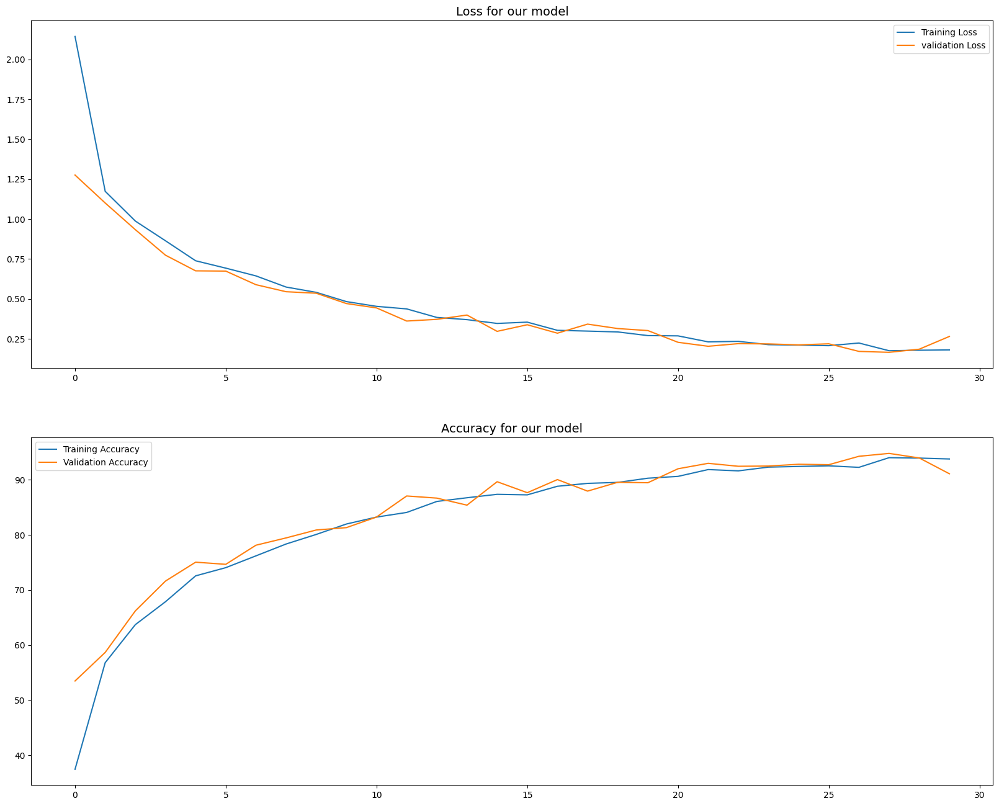

In [56]:
fig = plt.figure(num=2, figsize=(20, 16))
fig1 = fig.add_subplot(2, 1, 1)
fig2 = fig.add_subplot(2, 1, 2)

fig1.plot(total_loss_train, label = 'Training Loss')
fig1.plot(total_loss_val, label = 'validation Loss')
fig1.set_title('Loss for our model', fontsize = 14)
fig1.legend()
fig2.plot(total_acc_train, label = 'Training Accuracy')
fig2.plot(total_acc_val, label = 'Validation Accuracy')
fig2.set_title('Accuracy for our model', fontsize = 14)
fig2.legend()
plt.show()

In [57]:
# load the best model state into the CNN model
best_model_state = torch.load('CNN_model.pth', map_location = 'cpu')
CNN_model.load_state_dict(best_model_state)

CNN_model.to('cpu')

device = torch.device('cpu')
test_accuracy = test_model(CNN_model, test_loader, device)

print("------------------------------------------")
print(f"Best model\'s accuracy: {test_accuracy}")
print("------------------------------------------")


<ipython-input-57-308f0d1b71b3>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model_state = torch.load('CNN_model.pth', map_location = 'cpu')


------------------------------------------
Best model's accuracy: 94.48309335059052
------------------------------------------


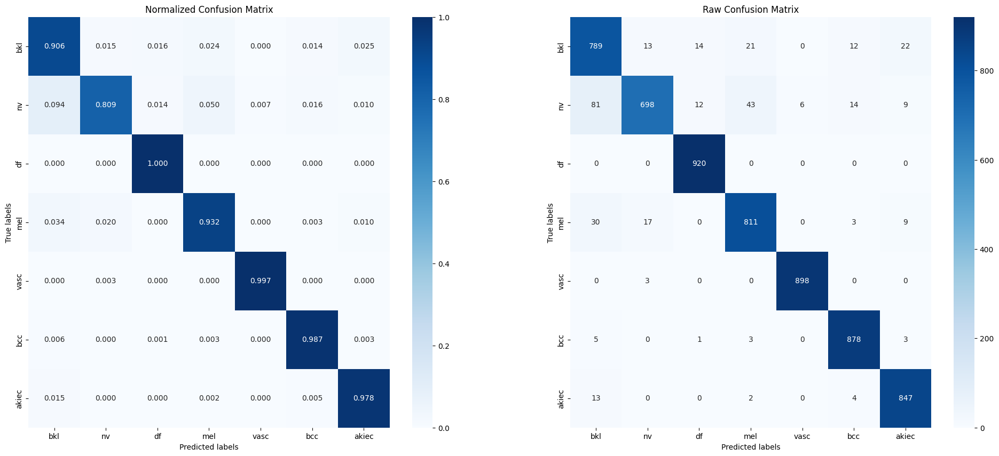

-------------------------------------------------------
Classification Report:

              precision    recall  f1-score   support

         bkl       0.86      0.91      0.88       871
          nv       0.95      0.81      0.88       863
          df       0.97      1.00      0.99       920
         mel       0.92      0.93      0.93       870
        vasc       0.99      1.00      1.00       901
         bcc       0.96      0.99      0.98       890
       akiec       0.95      0.98      0.96       866

    accuracy                           0.94      6181
   macro avg       0.95      0.94      0.94      6181
weighted avg       0.95      0.94      0.94      6181

-------------------------------------------------------


In [58]:
conf_report(CNN_model, test_loader, 'CNN_from_scratch')

# Grad-CAM

Grad-CAM (Gradient-weighted Class Activation Mapping) is useful for CNN-based architectures. It highlights regions in the image that have the most influence on the model's predictions by utilizing the gradients of target concepts.

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1640: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


Class: 0


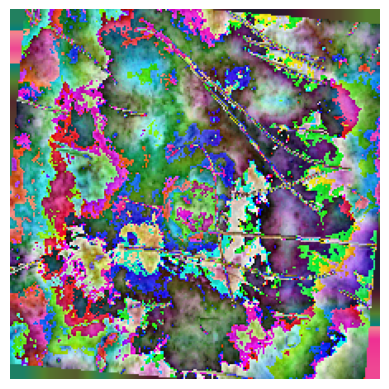

Class: 1


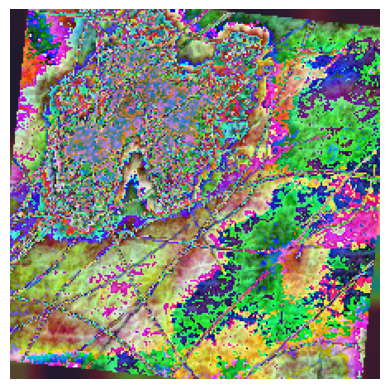

Class: 2


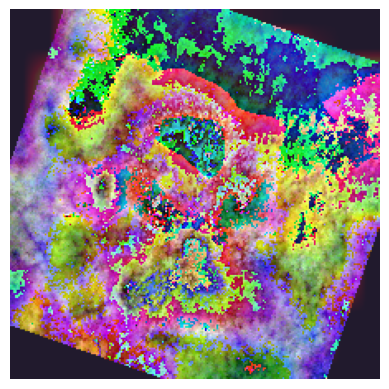

Class: 3


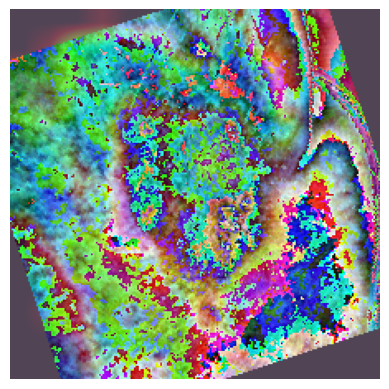

Class: 4


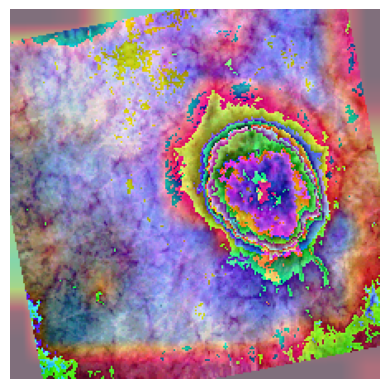

Class: 5


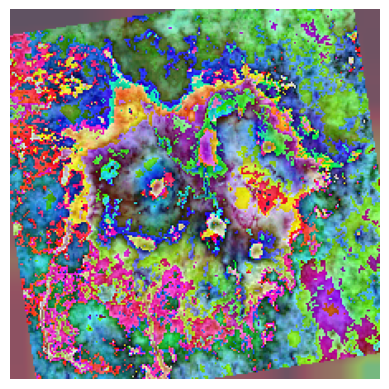

Class: 6


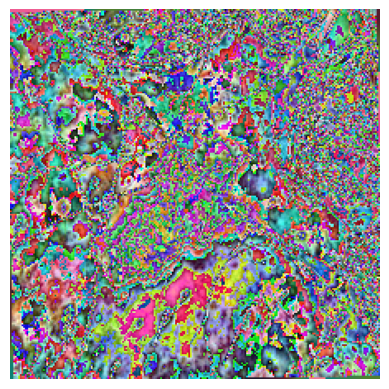

In [59]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import cv2
from torch.nn import functional as F

def grad_cam(model, image, target_class, last_conv_layer="layer4"):
    model.eval()
    gradients = []
    activations = []
    
    def backward_hook(module, grad_in, grad_out):
        gradients.append(grad_out[0])
    
    def forward_hook(module, input, output):
        activations.append(output)
    
    # Register hooks
    last_conv = getattr(model, last_conv_layer)
    last_conv.register_forward_hook(forward_hook)
    last_conv.register_backward_hook(backward_hook)
    
    # Forward pass
    output = model(image)
    target = output[0, target_class]
    
    # Backward pass
    model.zero_grad()
    target.backward()
    
    # Get gradients and activations
    gradients_ = gradients[0].cpu().data.numpy()[0]
    activations_ = activations[0].cpu().data.numpy()[0]
    
    # Compute weights
    weights = np.mean(gradients_, axis=(1, 2))
    
    # Generate Grad-CAM heatmap
    cam = np.zeros(activations_.shape[1:], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * activations_[i]
    
    cam = np.maximum(cam, 0)  # ReLU
    cam = cam / cam.max()  # Normalize
    return cam

def overlay_heatmap(image, heatmap, alpha=0.4, colormap=cv2.COLORMAP_JET):
    # Ensure `image` has the shape (3, H, W)
    if image.dim() == 4:
        image = image.squeeze(0)  # Remove the batch dimension if present
    
    # Convert heatmap to color map
    heatmap = cv2.resize(heatmap, (image.shape[1], image.shape[2]))  # Use correct dimensions here
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, colormap)
    
    # Convert image to numpy array for visualization
    image_np = image.cpu().numpy().transpose(1, 2, 0) * 255
    superimposed_img = heatmap * alpha + image_np
    superimposed_img = np.uint8(superimposed_img)
    
    plt.imshow(superimposed_img)
    plt.axis('off')
    plt.show()

# Apply Grad-CAM to one sample per class
for target_class in range(7):  # Assuming classes are labeled from 0 to 6
    # Find an example of the target class in the test loader
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        idx = (labels == target_class).nonzero(as_tuple=True)[0]
        
        if len(idx) > 0:  # If we found an example
            image = images[idx[0]].unsqueeze(0)  # Select the first occurrence
            heatmap = grad_cam(CNN_model, image, target_class)
            print(f"Class: {target_class}")
            overlay_heatmap(image.squeeze(0), heatmap)
            break  # Move to the next class

### Last Convolutional Layers

Class: 0 - bkl


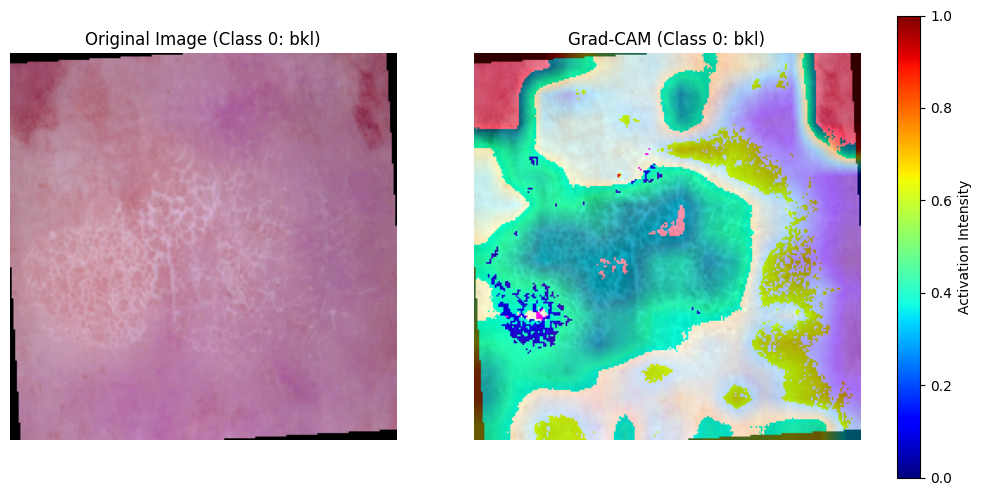

Class: 1 - nv


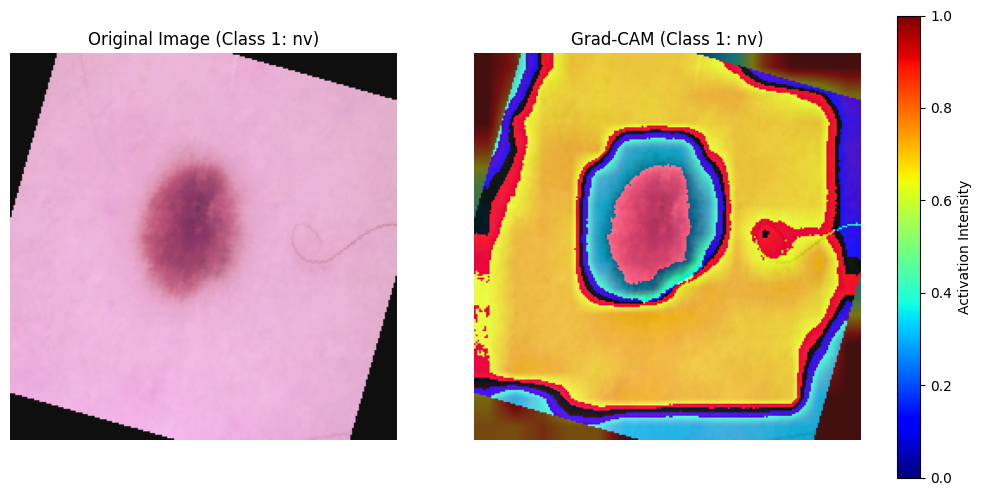

Class: 2 - df


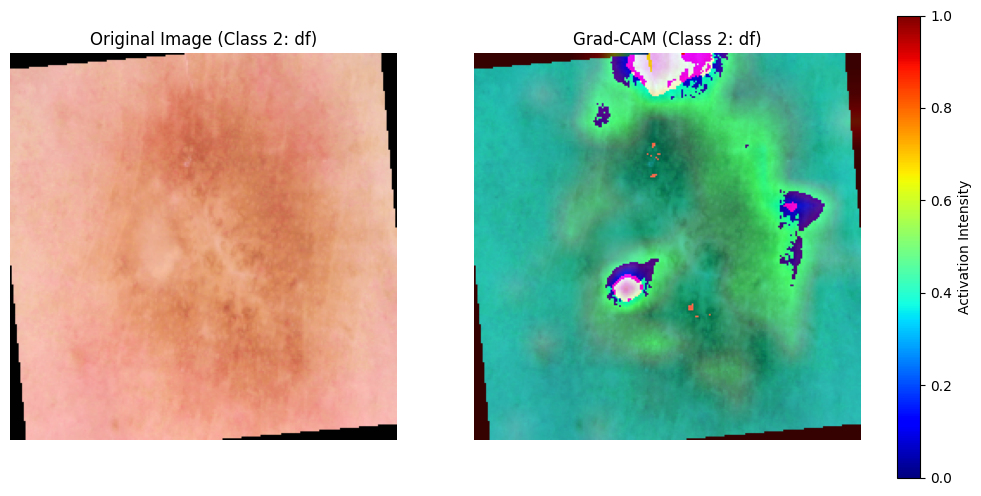

Class: 3 - mel


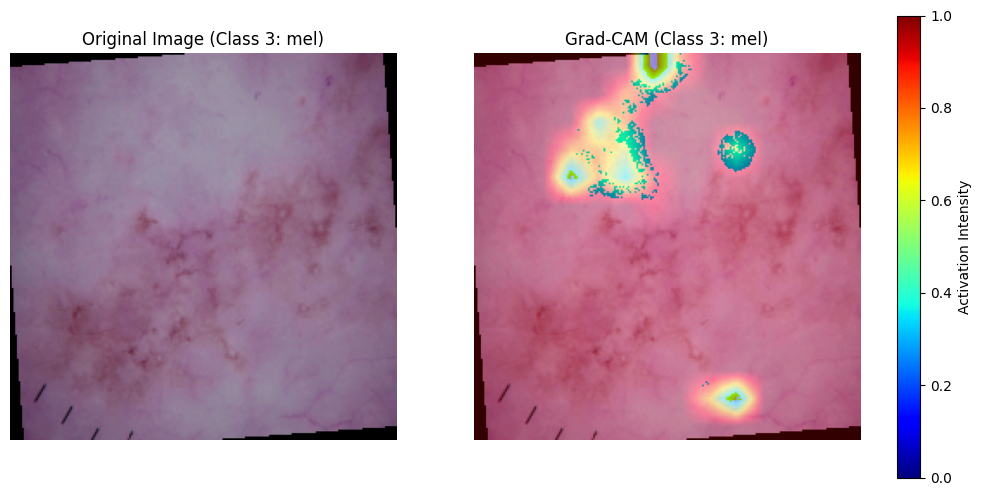

Class: 4 - vasc


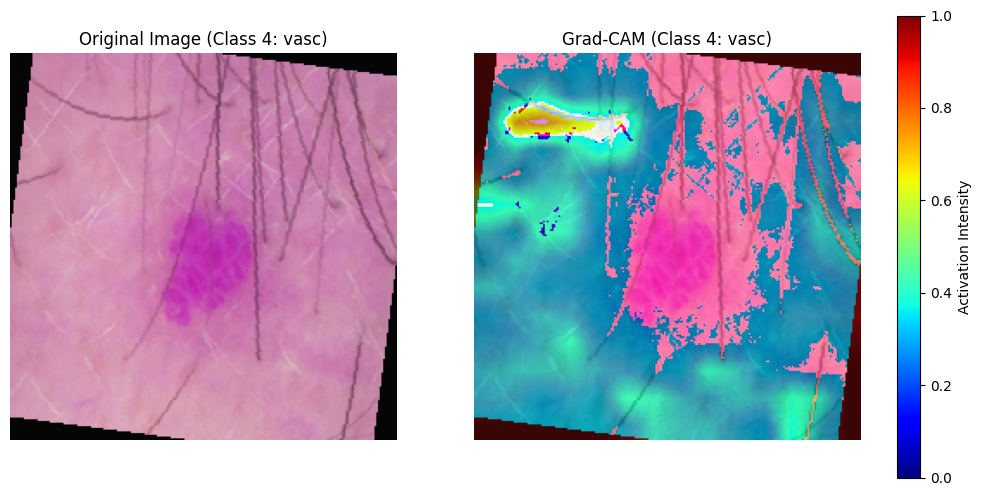

Class: 5 - bcc


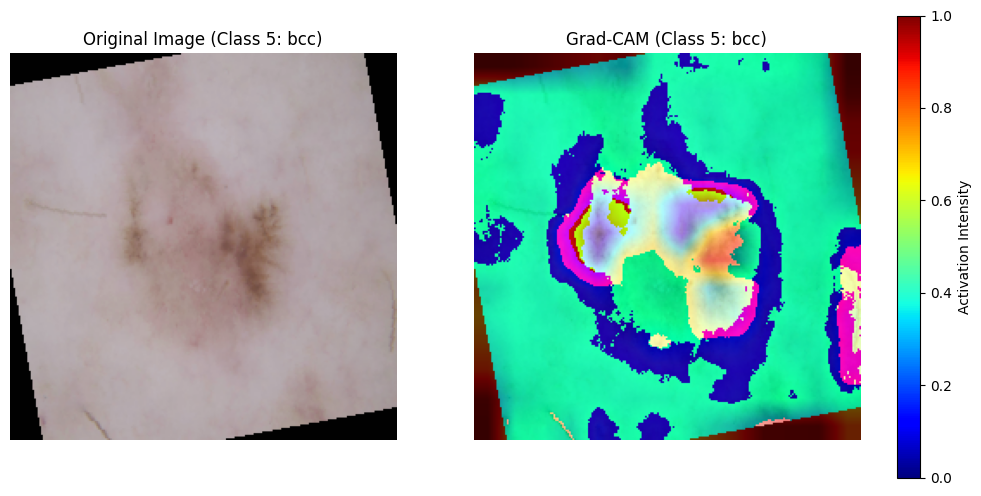

Class: 6 - akiec


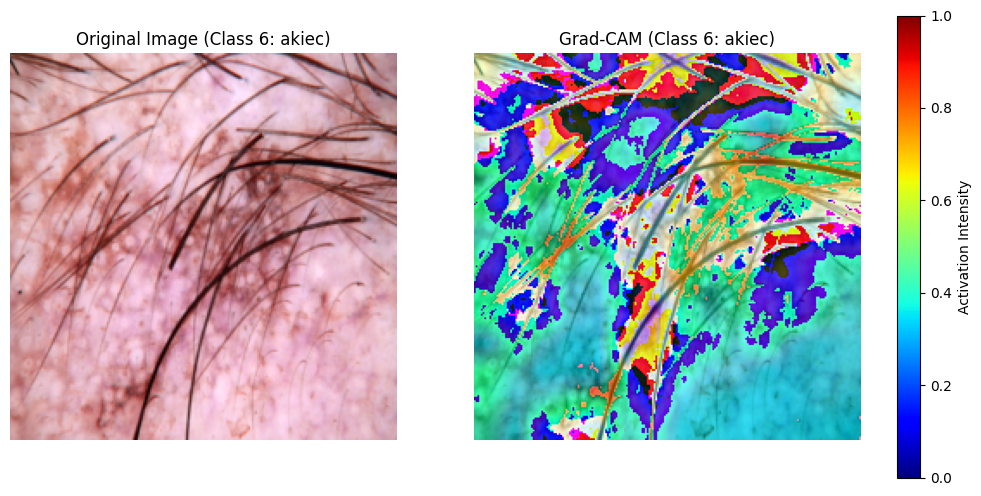

In [60]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import cv2
from torch.nn import functional as F

def grad_cam(model, image, target_class, last_conv_layer="layer4"):
    model.eval()
    gradients = []
    activations = []
    
    def backward_hook(module, grad_in, grad_out):
        gradients.append(grad_out[0])
    
    def forward_hook(module, input, output):
        activations.append(output)
    
    # Register hooks
    last_conv = getattr(model, last_conv_layer)
    last_conv.register_forward_hook(forward_hook)
    last_conv.register_backward_hook(backward_hook)
    
    # Forward pass
    output = model(image)
    target = output[0, target_class]
    
    # Backward pass
    model.zero_grad()
    target.backward()
    
    # Get gradients and activations
    gradients_ = gradients[0].cpu().data.numpy()[0]
    activations_ = activations[0].cpu().data.numpy()[0]
    
    # Compute weights
    weights = np.mean(gradients_, axis=(1, 2))
    
    # Generate Grad-CAM heatmap
    cam = np.zeros(activations_.shape[1:], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * activations_[i]
    
    cam = np.maximum(cam, 0)  # ReLU
    cam = cam / cam.max()  # Normalize
    return cam

def overlay_heatmap(image, heatmap, alpha=0.4, colormap=cv2.COLORMAP_JET):
    if image.dim() == 4:
        image = image.squeeze(0)  # Remove batch dimension if present
    
    # Resize heatmap to match image size and apply color map
    heatmap = cv2.resize(heatmap, (image.shape[1], image.shape[2]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, colormap)
    
    # Convert image tensor to numpy for overlay
    image_np = image.cpu().numpy().transpose(1, 2, 0) * 255
    superimposed_img = heatmap * alpha + image_np
    superimposed_img = np.uint8(superimposed_img)
    
    return image_np, superimposed_img

def reverse_normalization(image, mean, std):
    for i in range(3):  # Assuming 3 channels (RGB)
        image[i] = image[i] * std[i] + mean[i]
    return image


# Define the class mapping
class_labels = {
    'bkl': 0,
    'nv': 1,
    'df': 2,
    'mel': 3,
    'vasc': 4,
    'bcc': 5,
    'akiec': 6
}

# Reverse mapping for easy lookup by index
index_to_class = {v: k for k, v in class_labels.items()}

def display_grad_cam(image, heatmap, target_class):
    # Reverse normalization for visualization
    mean = [0.77148203, 0.55764165, 0.58345652]
    std = [0.12655577, 0.14245141, 0.15189891]
    image = reverse_normalization(image.clone(), mean, std)

    # Overlay original and heatmap
    original_img, grad_cam_img = overlay_heatmap(image, heatmap)

    # Retrieve class name using target_class
    class_name = index_to_class.get(target_class, "Unknown")

    # Create figure with a color bar
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].imshow(original_img.astype(np.uint8))
    ax[0].set_title(f"Original Image (Class {target_class}: {class_name})")
    ax[0].axis('off')
    
    ax[1].imshow(grad_cam_img)
    ax[1].set_title(f"Grad-CAM (Class {target_class}: {class_name})")
    ax[1].axis('off')
    
    # Add color bar for significance of the colors
    colorbar_img = plt.cm.ScalarMappable(cmap='jet')
    plt.colorbar(colorbar_img, ax=ax, orientation='vertical', fraction=0.046, pad=0.04, label='Activation Intensity')
    plt.show()

# Loop through each class and apply Grad-CAM on a random image
for target_class in range(7):  # Assuming classes are labeled from 0 to 6
    target_images = []
    
    # Collect images of the current target class
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        indices = (labels == target_class).nonzero(as_tuple=True)[0]
        
        for idx in indices:
            target_images.append(images[idx].unsqueeze(0))
    
    if target_images:
        # Select a random image from the target class
        image = random.choice(target_images)
        heatmap = grad_cam(CNN_model, image, target_class)
        print(f"Class: {target_class} - {index_to_class[target_class]}")
        display_grad_cam(image.squeeze(0), heatmap, target_class)



Class 0 - bkl


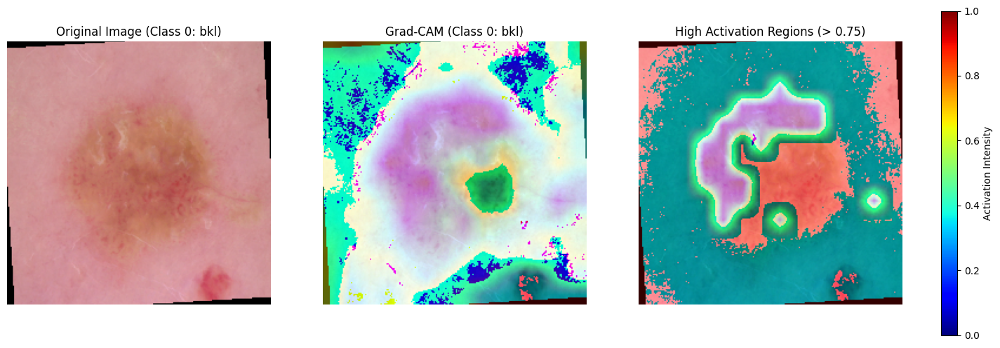

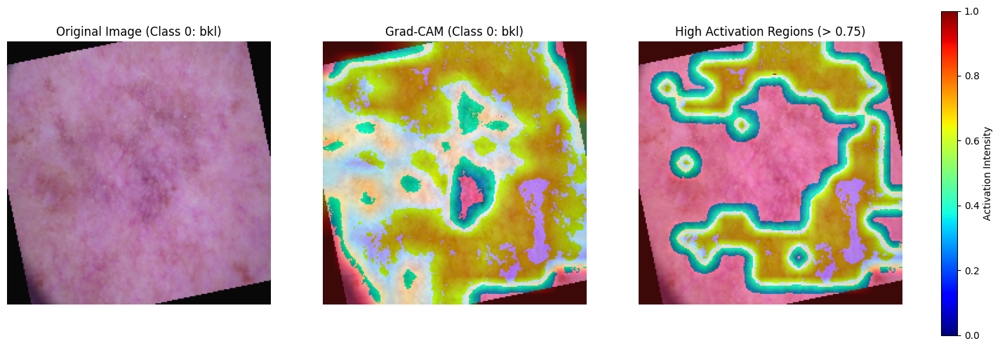

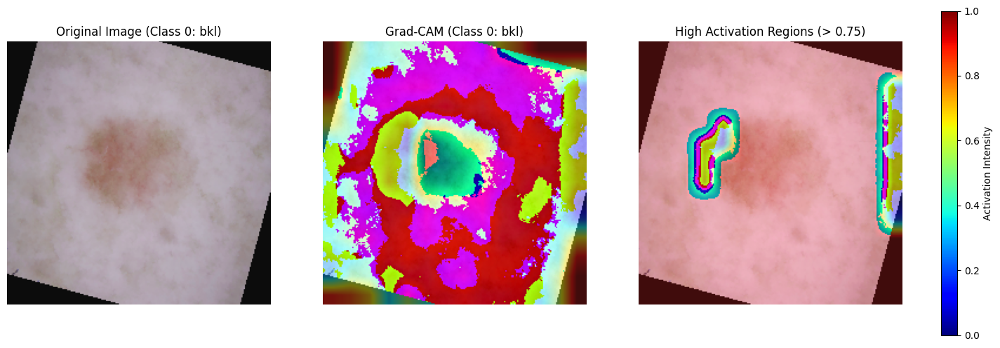

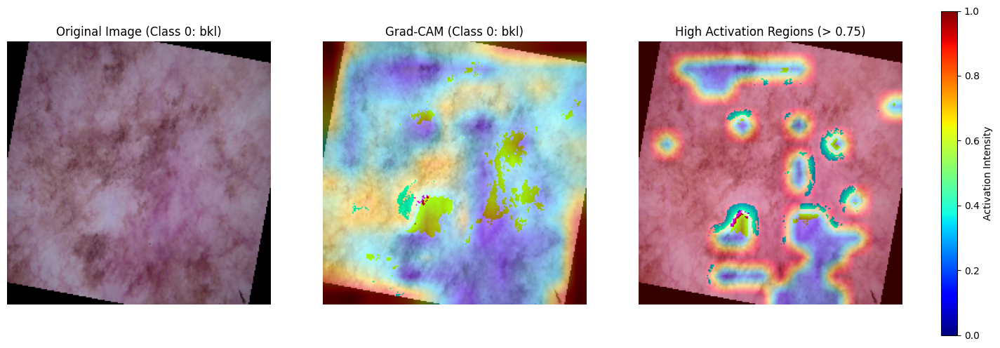


Class 1 - nv


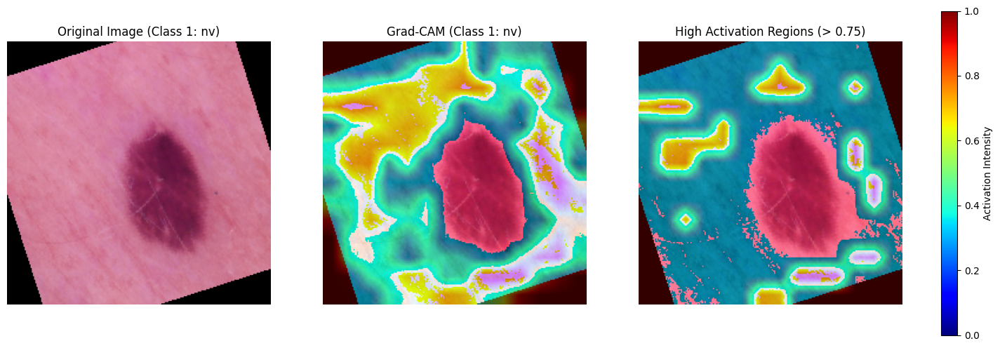

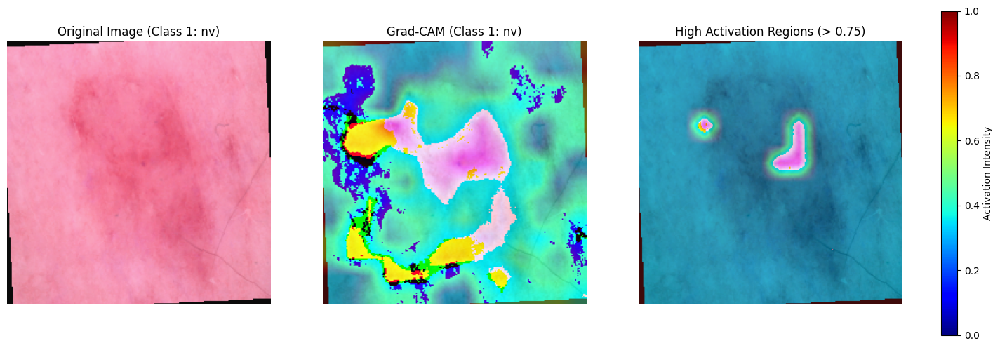

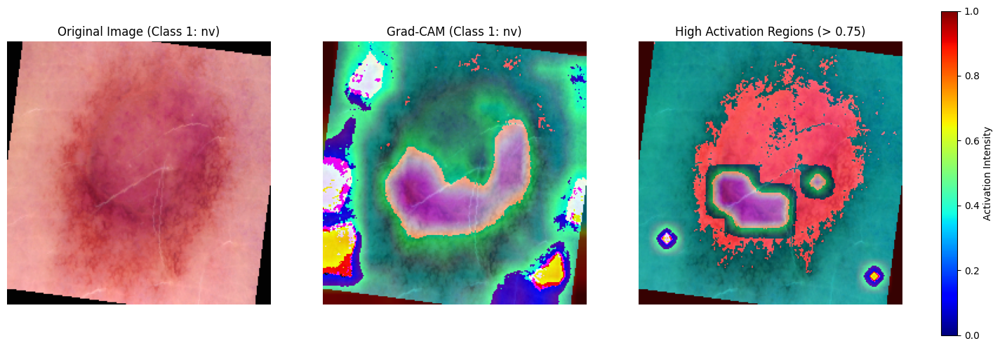

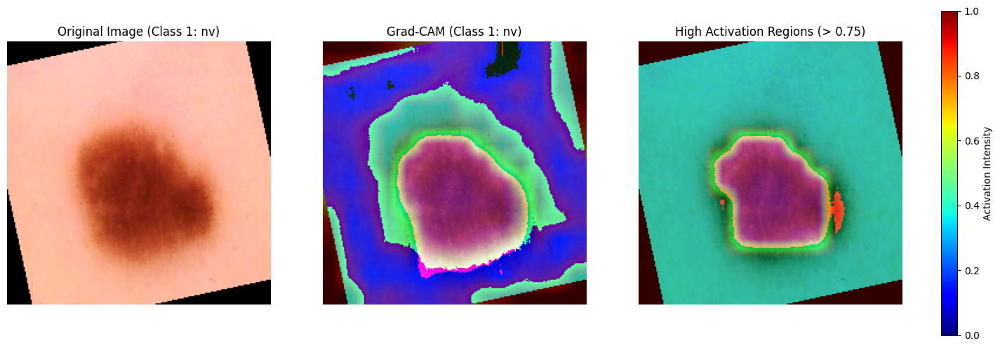


Class 2 - df


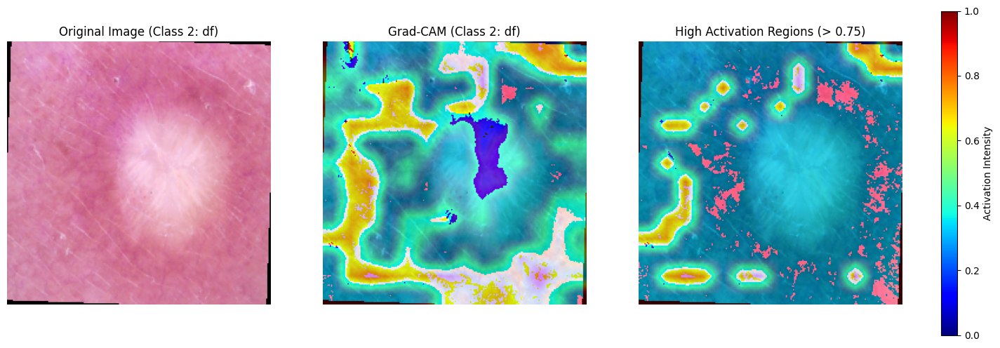

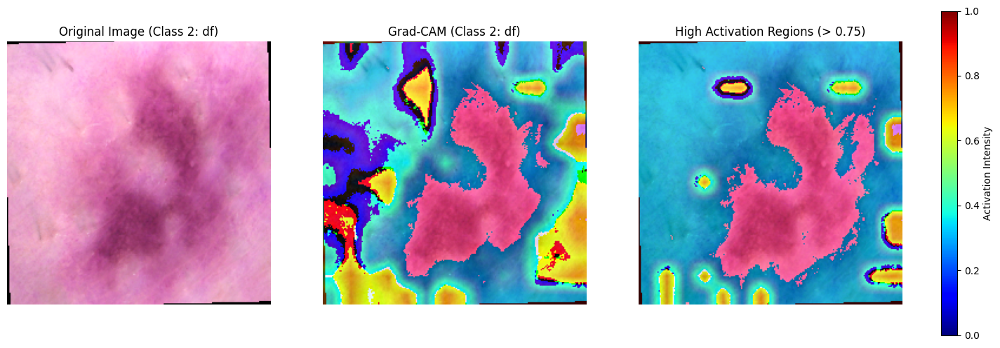

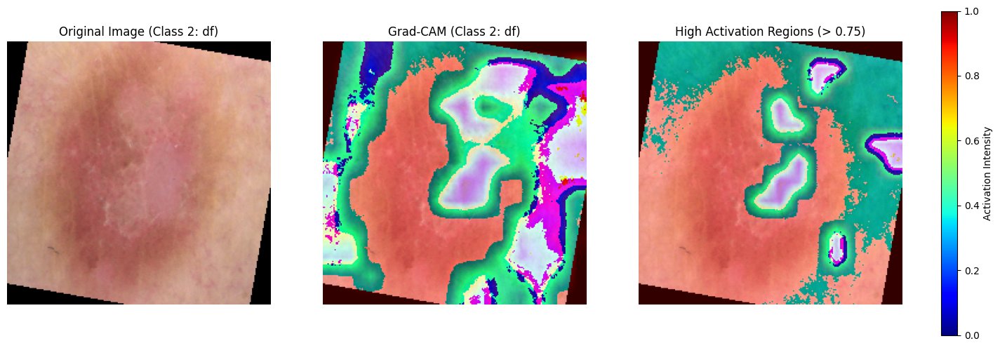

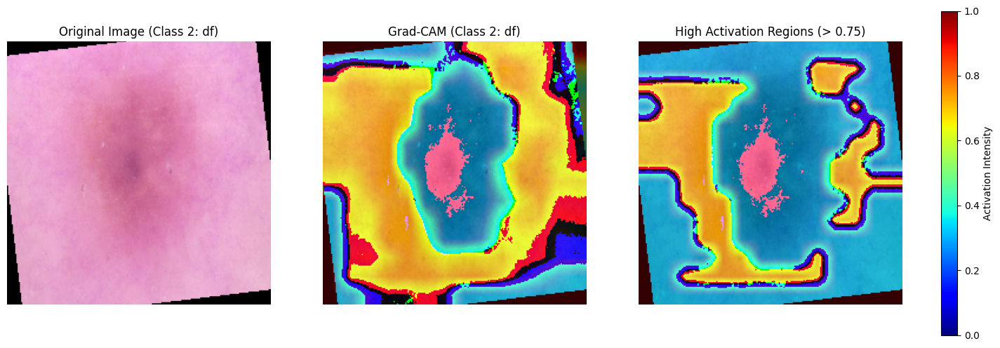


Class 3 - mel


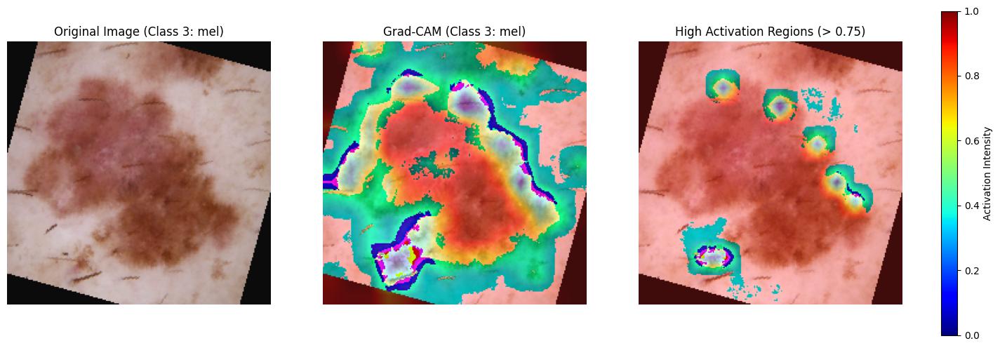

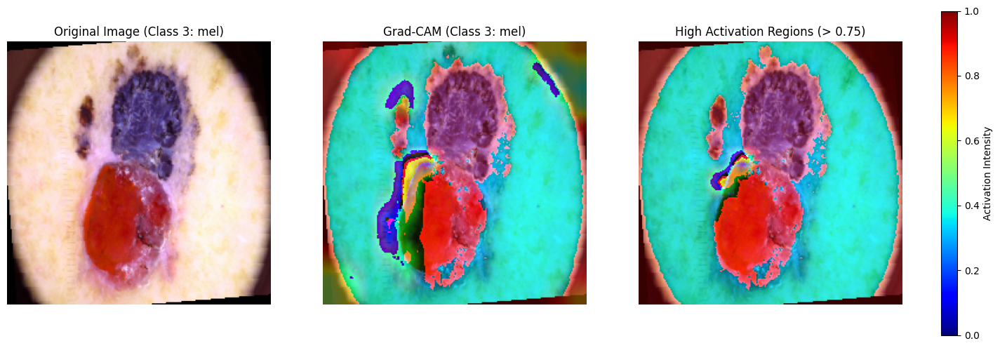

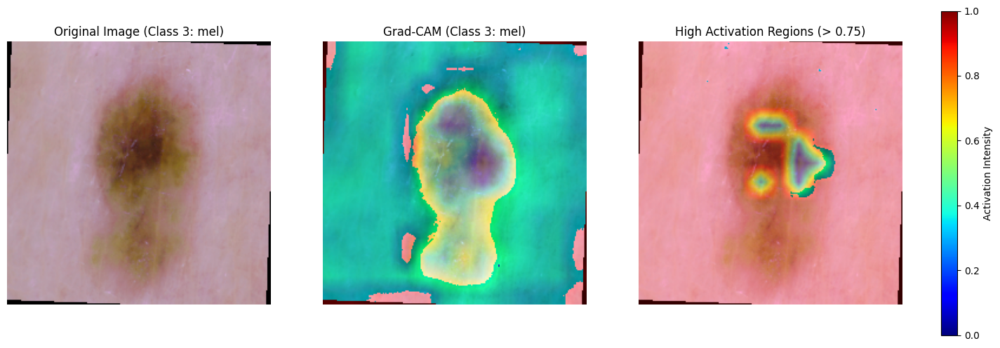

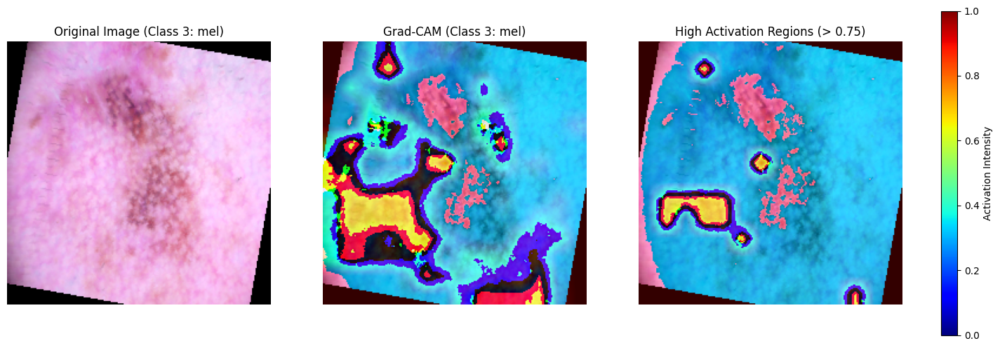


Class 4 - vasc


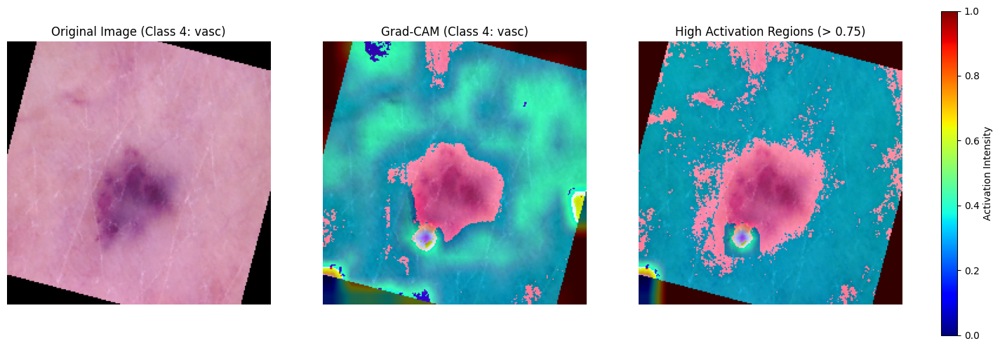

<ipython-input-60-eda1baaddb29>:44: RuntimeWarning: invalid value encountered in divide
  cam = cam / cam.max()  # Normalize
<ipython-input-60-eda1baaddb29>:53: RuntimeWarning: invalid value encountered in cast
  heatmap = np.uint8(255 * heatmap)
<ipython-input-61-bac8540d5449>:30: RuntimeWarning: invalid value encountered in cast
  thresholded_heatmap = np.uint8(255 * thresholded_heatmap)


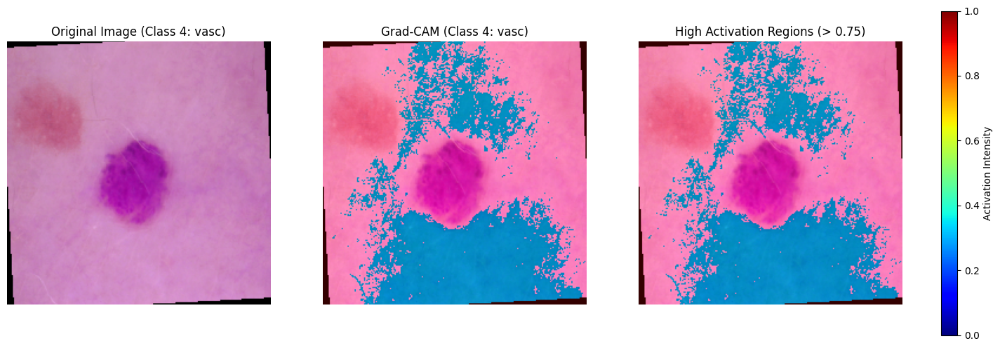

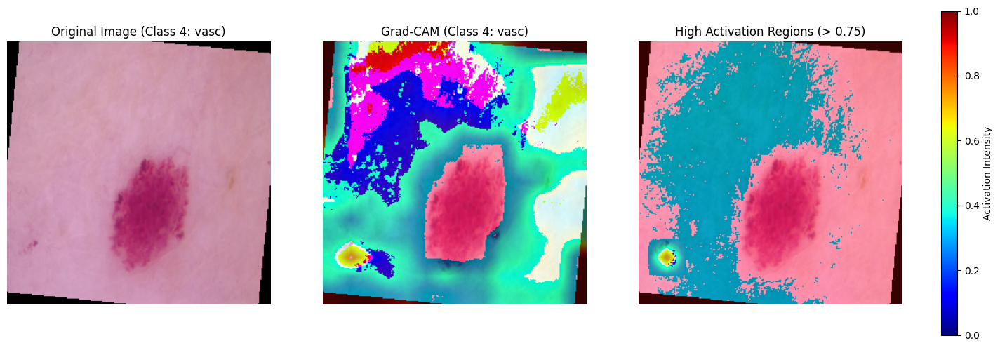

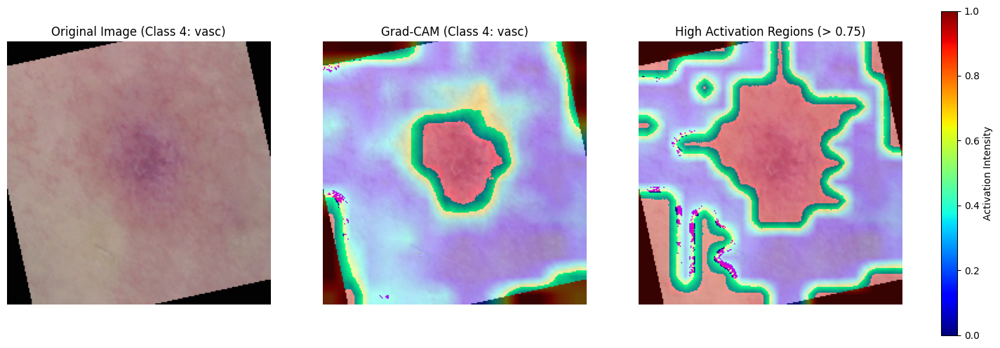


Class 5 - bcc


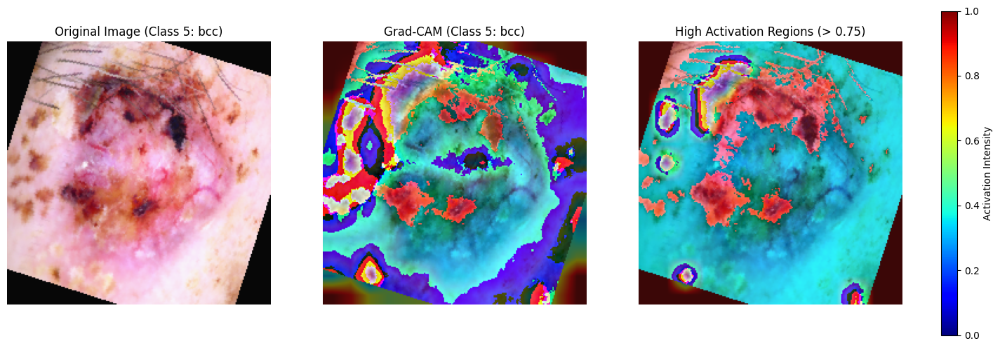

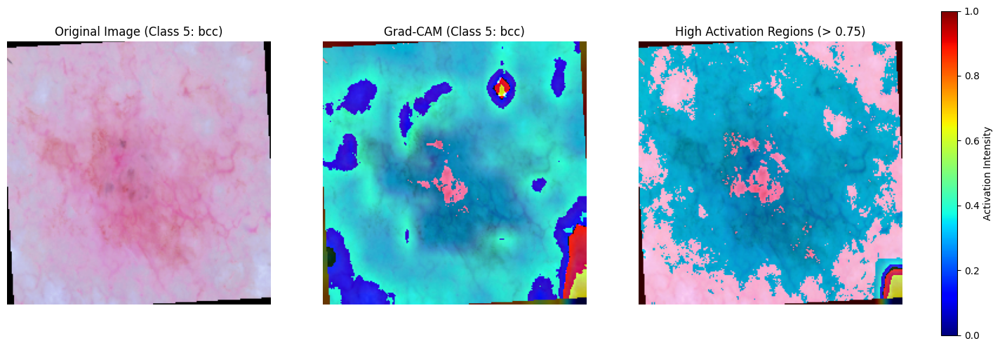

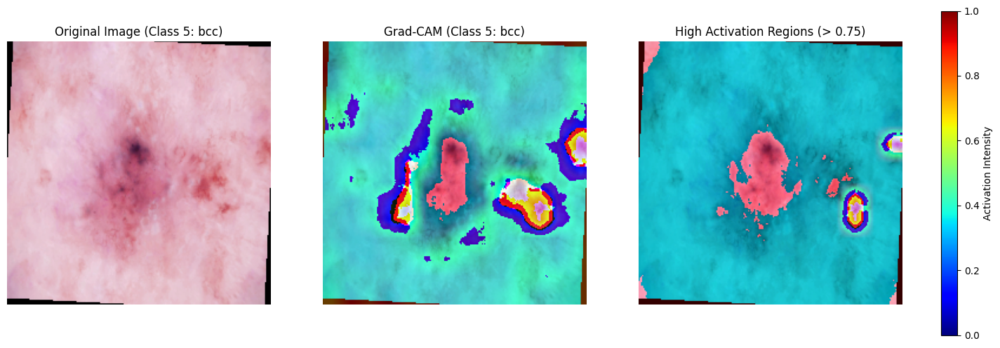

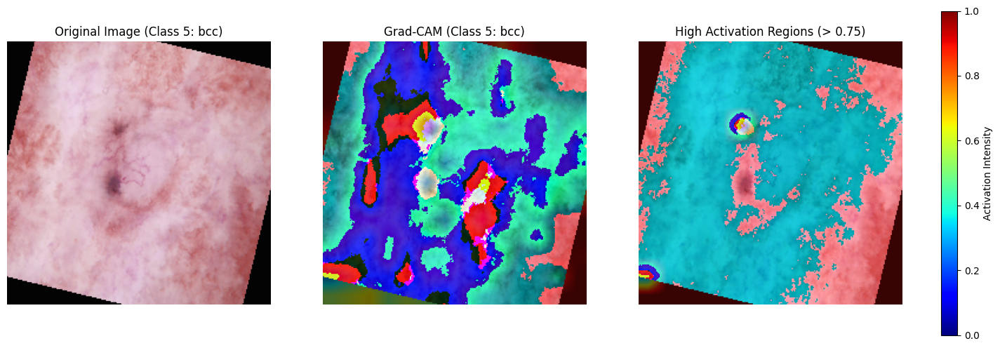


Class 6 - akiec


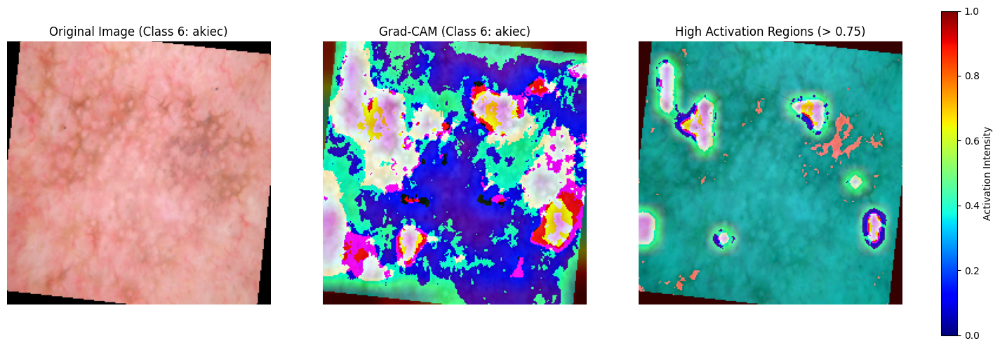

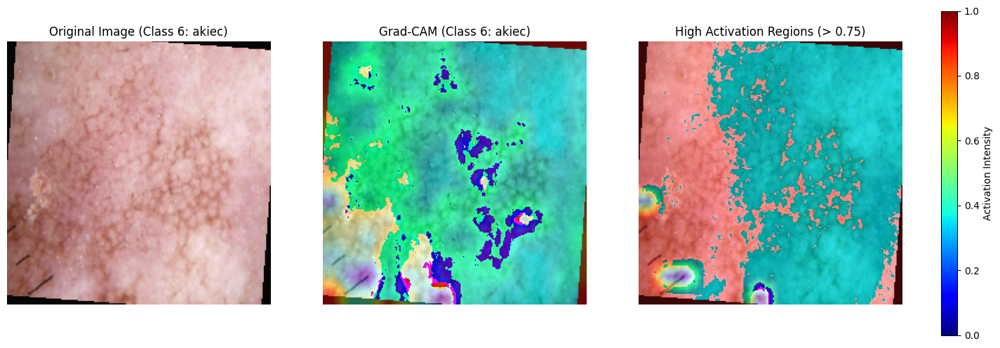

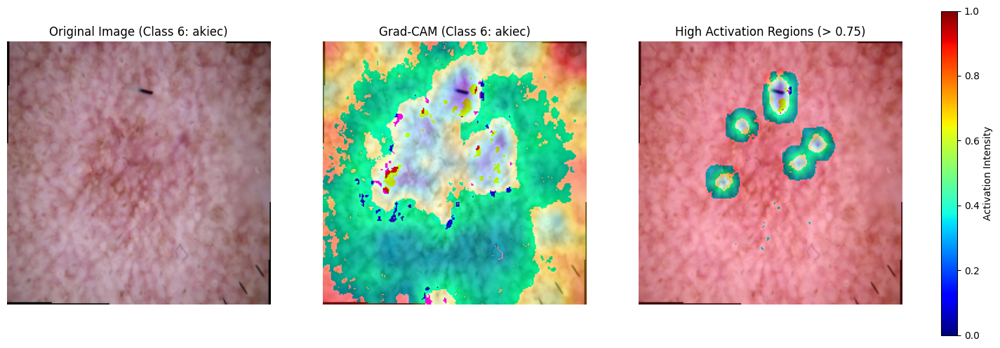

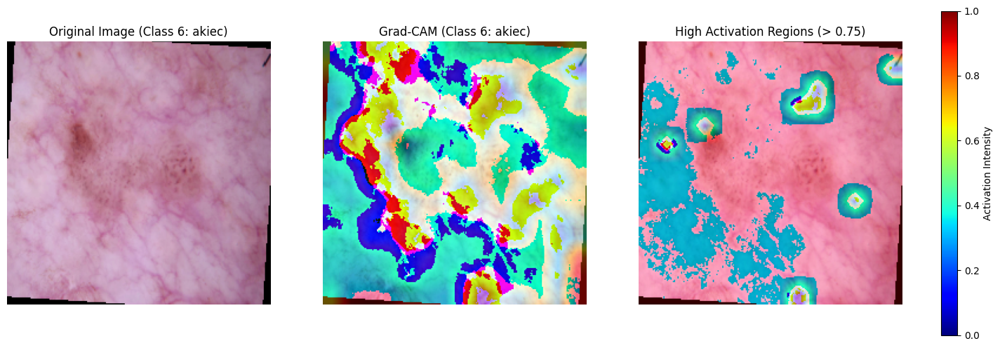

In [61]:
import random

# Define the class mapping
class_labels = {
    'bkl': 0,
    'nv': 1,
    'df': 2,
    'mel': 3,
    'vasc': 4,
    'bcc': 5,
    'akiec': 6
}

# Reverse mapping for easy lookup by index
index_to_class = {v: k for k, v in class_labels.items()}

def display_grad_cam_with_threshold(image, heatmap, target_class):
    # Reverse normalization for visualization
    mean = [0.77148203, 0.55764165, 0.58345652]
    std = [0.12655577, 0.14245141, 0.15189891]
    image = reverse_normalization(image.clone(), mean, std)

    # Overlay original and heatmap
    original_img, grad_cam_img = overlay_heatmap(image, heatmap)

    # Apply thresholding to show only high-activation regions
    thresholded_heatmap = heatmap.copy()
    thresholded_heatmap[thresholded_heatmap < 0.75] = 0  # Mask out areas below 0.75
    thresholded_heatmap = cv2.resize(thresholded_heatmap, (image.shape[1], image.shape[2]))
    thresholded_heatmap = np.uint8(255 * thresholded_heatmap)
    thresholded_heatmap = cv2.applyColorMap(thresholded_heatmap, cv2.COLORMAP_JET)

    # Combine thresholded heatmap with the original image for display
    highlighted_img = thresholded_heatmap * 0.4 + original_img

    # Retrieve class name using target_class
    class_name = index_to_class.get(target_class, "Unknown")

    # Create figure with color bar
    fig, ax = plt.subplots(1, 3, figsize=(18, 6))
    ax[0].imshow(original_img.astype(np.uint8))
    ax[0].set_title(f"Original Image (Class {target_class}: {class_name})")
    ax[0].axis('off')
    
    ax[1].imshow(grad_cam_img)
    ax[1].set_title(f"Grad-CAM (Class {target_class}: {class_name})")
    ax[1].axis('off')
    
    ax[2].imshow(highlighted_img.astype(np.uint8))
    ax[2].set_title("High Activation Regions (> 0.75)")
    ax[2].axis('off')
    
    # Add color bar for significance of the colors
    colorbar_img = plt.cm.ScalarMappable(cmap='jet')
    plt.colorbar(colorbar_img, ax=ax, orientation='vertical', fraction=0.046, pad=0.04, label='Activation Intensity')
    plt.show()

# Loop through each class and apply Grad-CAM on 4 random images
for target_class in range(7):  # Assuming classes are labeled from 0 to 6
    target_images = []
    
    # Collect images of the current target class
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        indices = (labels == target_class).nonzero(as_tuple=True)[0]
        
        for idx in indices:
            target_images.append(images[idx].unsqueeze(0))
    
    if len(target_images) >= 4:
        # Select 4 random images from the target class
        selected_images = random.sample(target_images, 4)
        print(f"\nClass {target_class} - {index_to_class[target_class]}")
        
        for image in selected_images:
            heatmap = grad_cam(CNN_model, image, target_class)
            display_grad_cam_with_threshold(image.squeeze(0), heatmap, target_class)


## Early and Intermediate Convolutional Layers

In [62]:
import random
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt

def grad_cam_layer(model, image, target_class, target_layer):
    model.eval()
    gradients = []
    activations = []
    
    def backward_hook(module, grad_in, grad_out):
        gradients.append(grad_out[0])
    
    def forward_hook(module, input, output):
        activations.append(output)
    
    # Register hooks on the specified layer
    layer = getattr(model, target_layer)
    layer.register_forward_hook(forward_hook)
    layer.register_backward_hook(backward_hook)
    
    # Forward pass
    output = model(image)
    target = output[0, target_class]
    
    # Backward pass
    model.zero_grad()
    target.backward()
    
    # Get gradients and activations
    gradients_ = gradients[0].cpu().data.numpy()[0]
    activations_ = activations[0].cpu().data.numpy()[0]
    
    # Compute weights
    weights = np.mean(gradients_, axis=(1, 2))
    
    # Generate Grad-CAM heatmap
    cam = np.zeros(activations_.shape[1:], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * activations_[i]
    
    # Safe normalization
    if cam.max() > 0:
        cam = cam / cam.max()  # Normalize only if max value is non-zero
    else:
        cam = np.zeros_like(cam)  # Set to zeros if normalization is not possible
    
    return cam

def display_grad_cam_layer(image, heatmap, layer_name, target_class, class_name):
    # Reverse normalization for visualization
    mean = [0.77148203, 0.55764165, 0.58345652]
    std = [0.12655577, 0.14245141, 0.15189891]
    image = reverse_normalization(image.clone(), mean, std)

    # Overlay original and heatmap
    original_img, grad_cam_img = overlay_heatmap(image, heatmap)

    # Create figure
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].imshow(original_img.astype(np.uint8))
    ax[0].set_title(f"Original Image (Class {target_class}: {class_name})")
    ax[0].axis('off')
    
    ax[1].imshow(grad_cam_img)
    ax[1].set_title(f"Grad-CAM at {layer_name} (Class {target_class}: {class_name})")
    ax[1].axis('off')
    
    plt.show()


## Grad-CAM for Early Layer


Class 0 - bkl


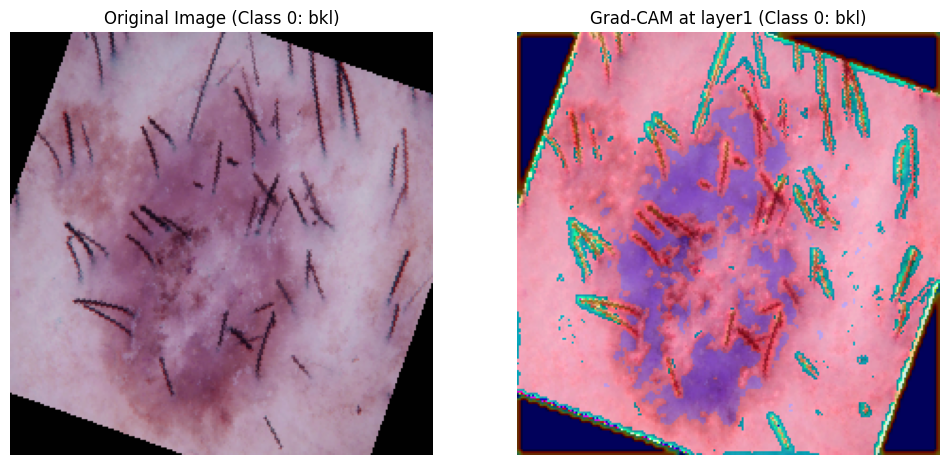

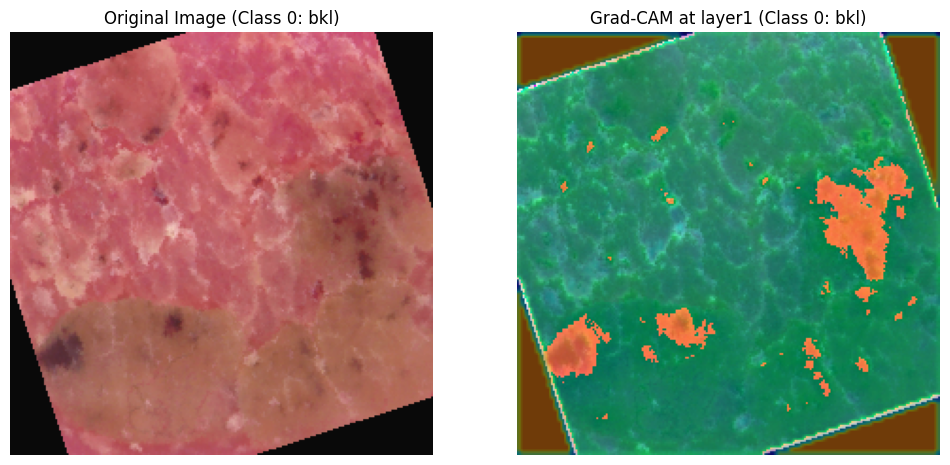


Class 1 - nv


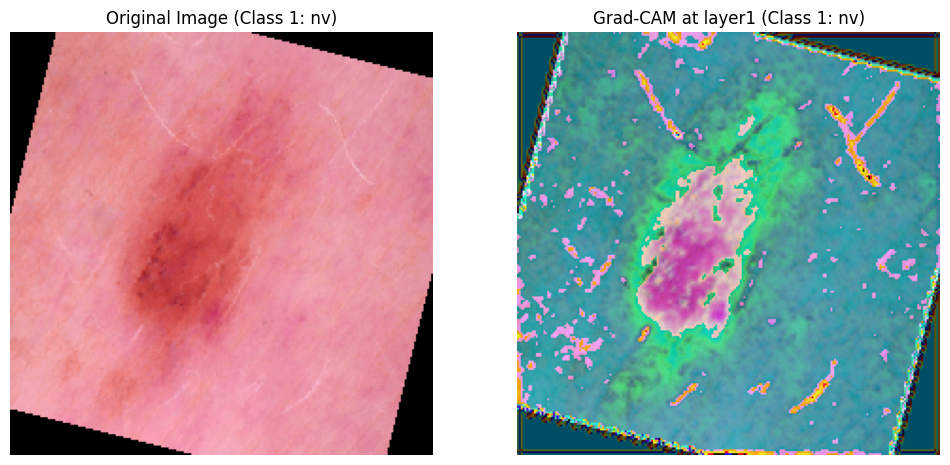

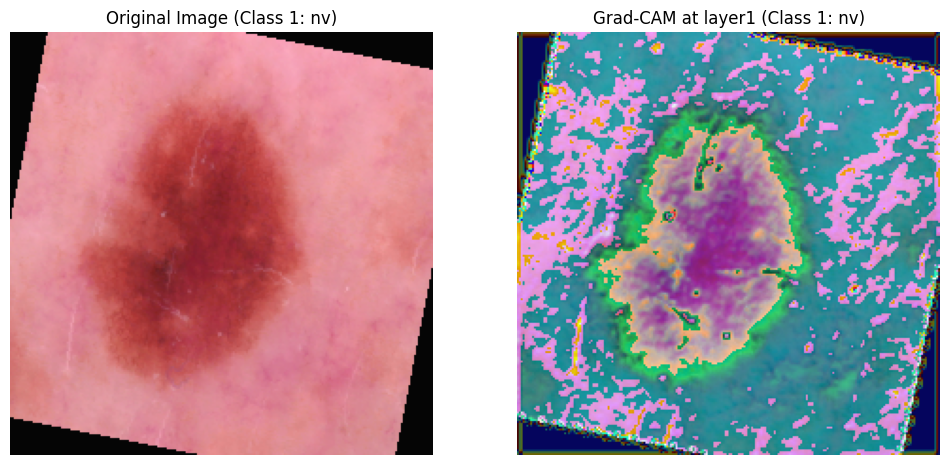


Class 2 - df


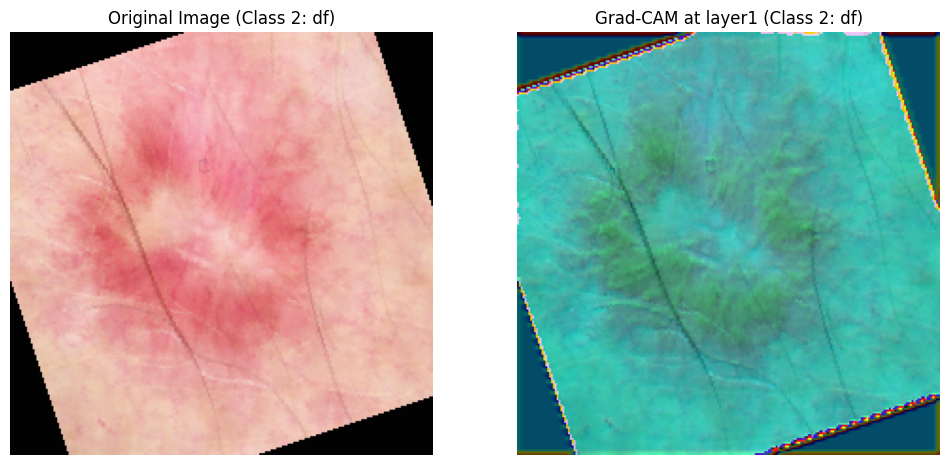

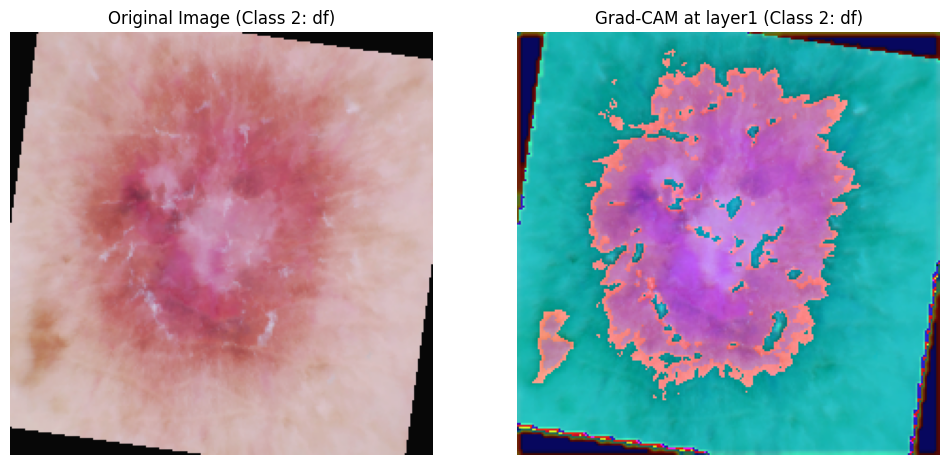


Class 3 - mel


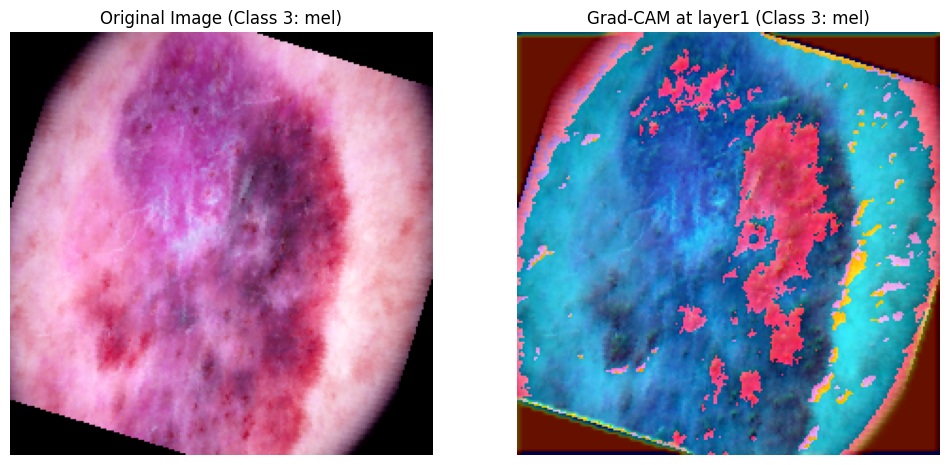

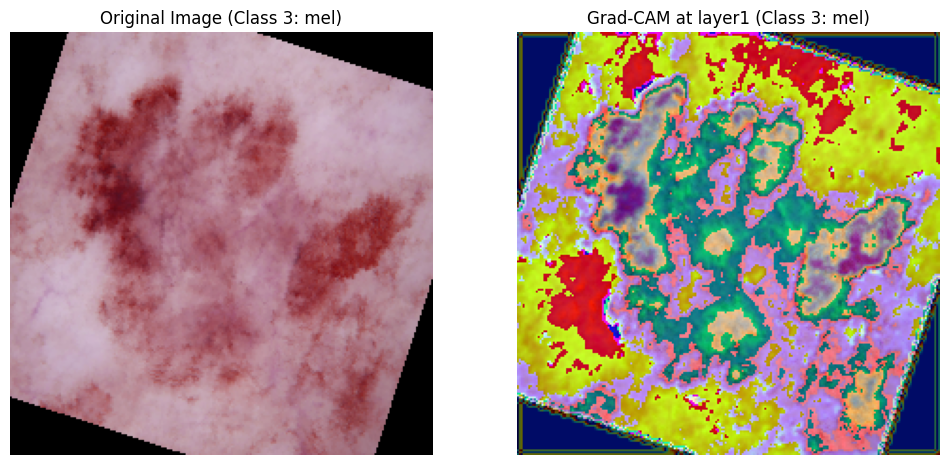


Class 4 - vasc


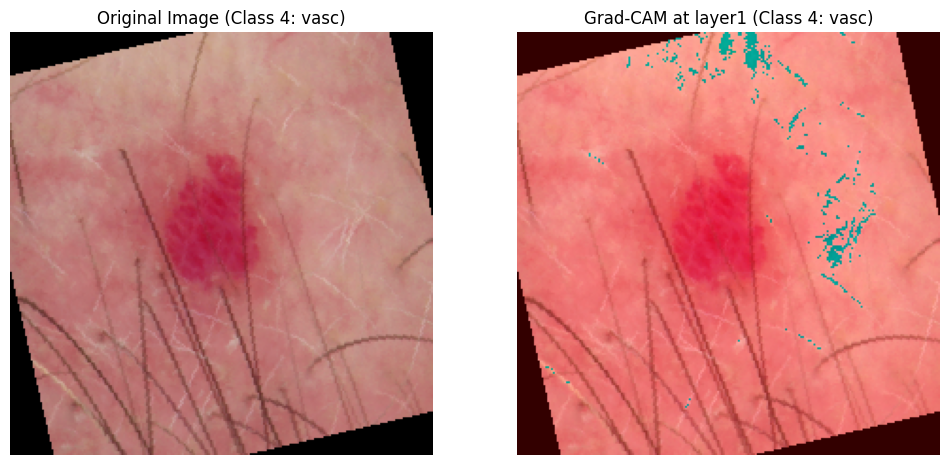

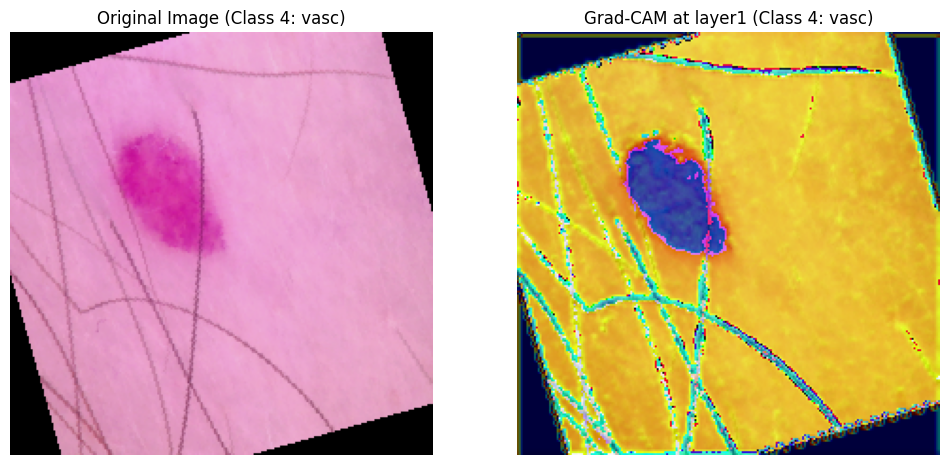


Class 5 - bcc


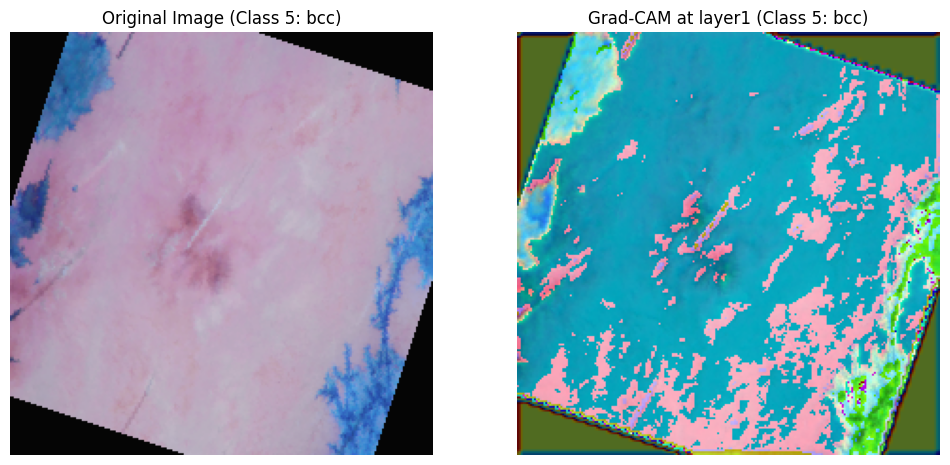

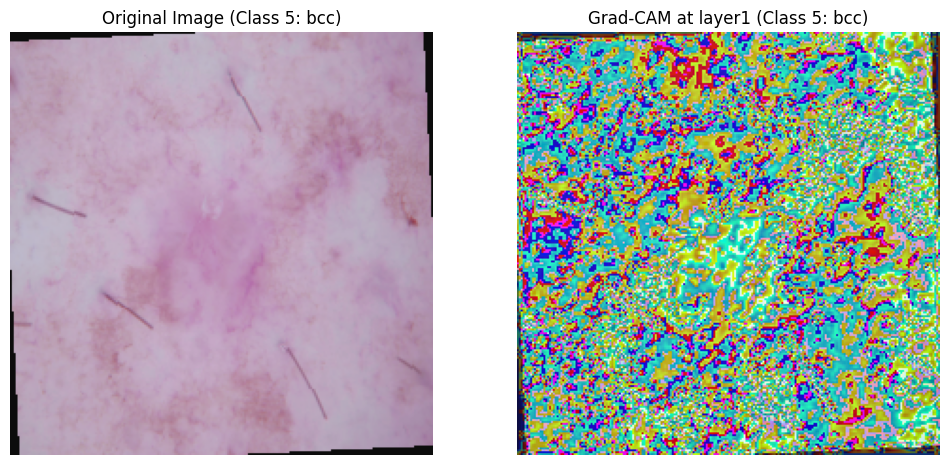


Class 6 - akiec


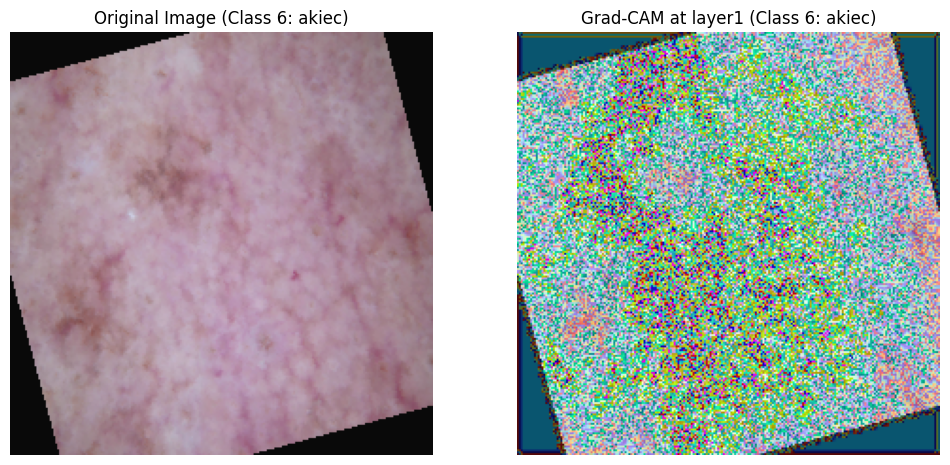

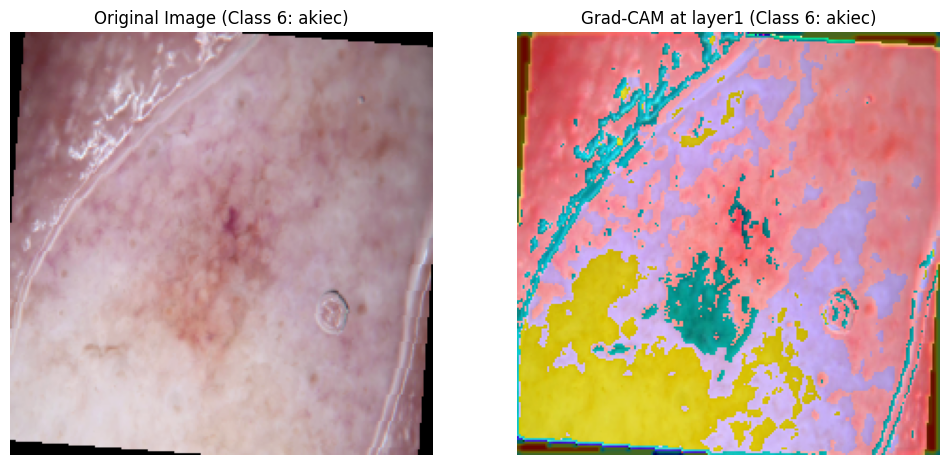

In [63]:
# Define the class mapping
class_labels = {
    'bkl': 0,
    'nv': 1,
    'df': 2,
    'mel': 3,
    'vasc': 4,
    'bcc': 5,
    'akiec': 6
}

# Reverse mapping for easy lookup by index
index_to_class = {v: k for k, v in class_labels.items()}

# Loop through each class and apply Grad-CAM on 2 random images at early layer
for target_class in range(7):
    target_images = []
    
    # Collect images of the current target class
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        indices = (labels == target_class).nonzero(as_tuple=True)[0]
        
        for idx in indices:
            target_images.append(images[idx].unsqueeze(0))
    
    if len(target_images) >= 2:
        selected_images = random.sample(target_images, 2)
        class_name = index_to_class[target_class]
        
        print(f"\nClass {target_class} - {class_name}")
        
        for image in selected_images:
            heatmap = grad_cam_layer(CNN_model, image, target_class, "layer1")
            display_grad_cam_layer(image.squeeze(0), heatmap, "layer1", target_class, class_name)


## Grad-CAM for Intermediate Layer


Class 0 - bkl


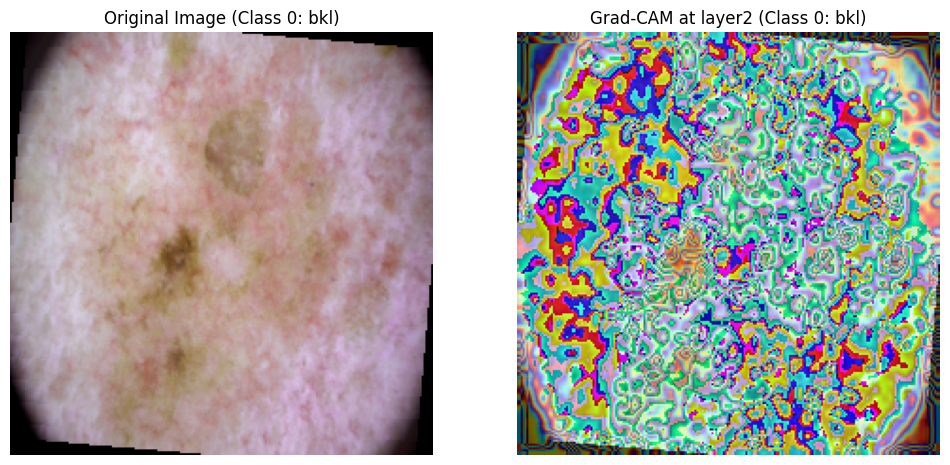

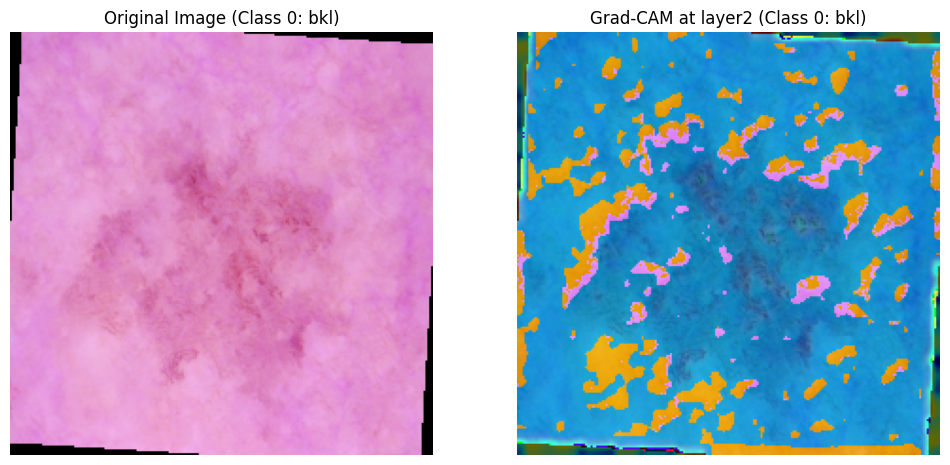


Class 1 - nv


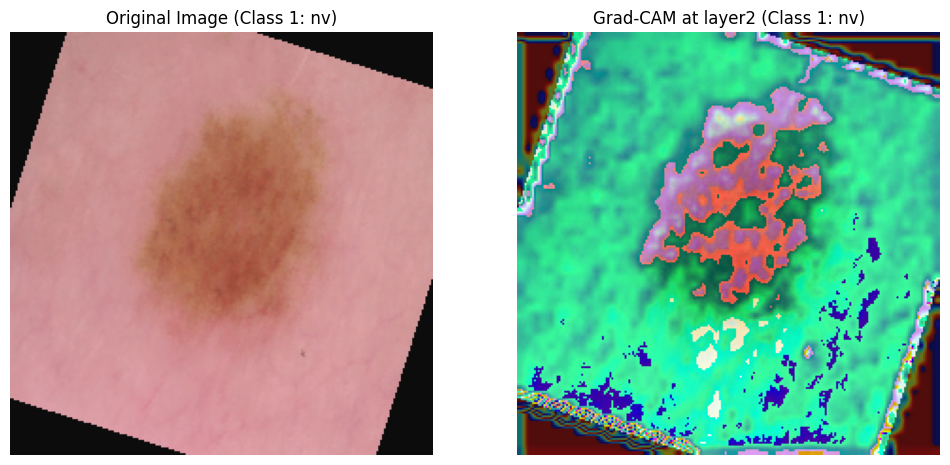

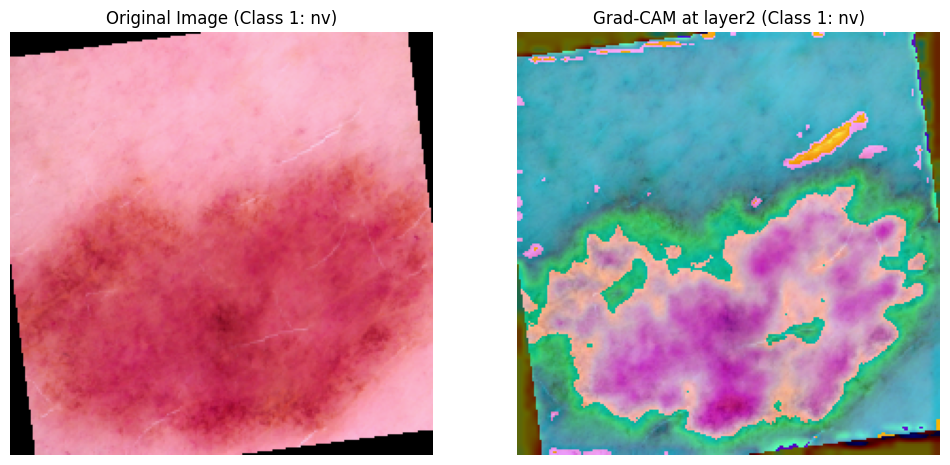


Class 2 - df


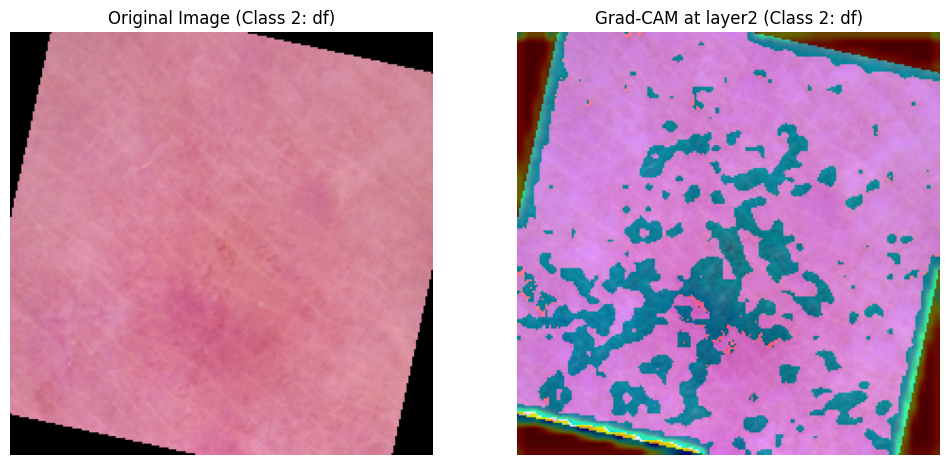

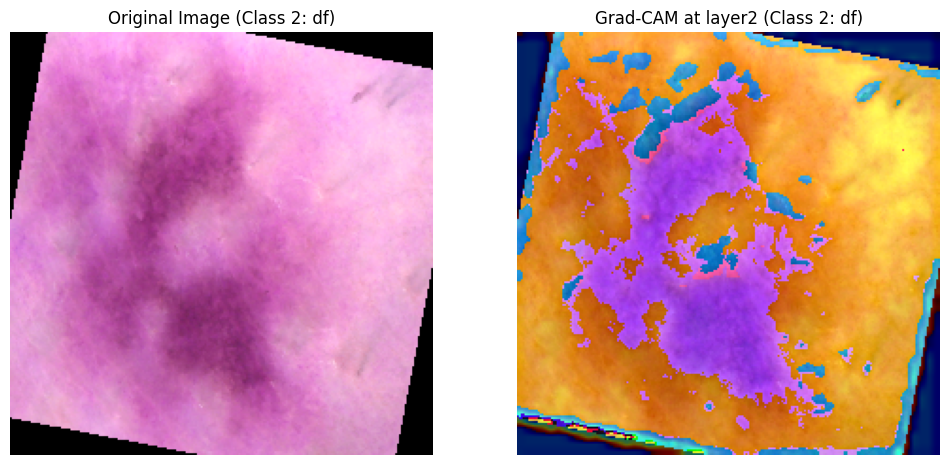


Class 3 - mel


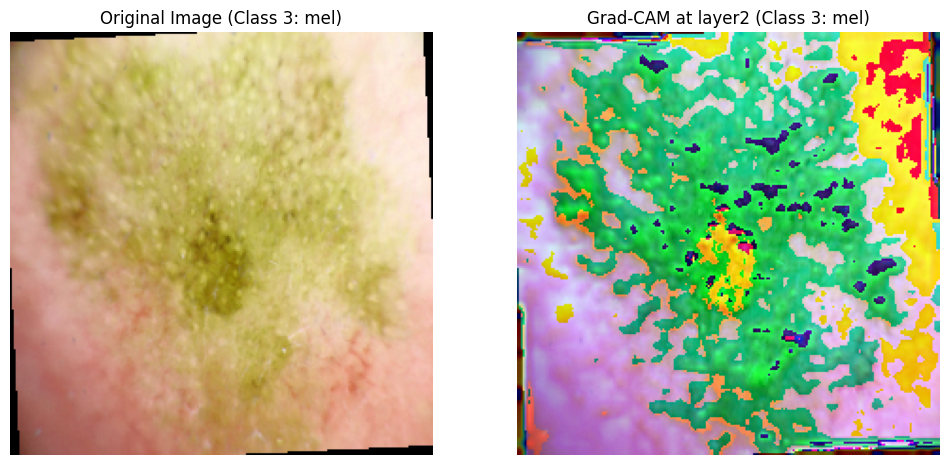

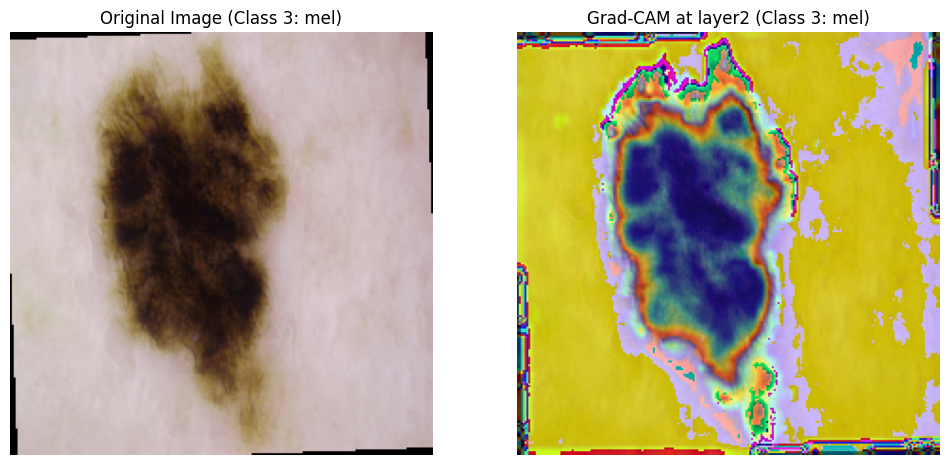


Class 4 - vasc


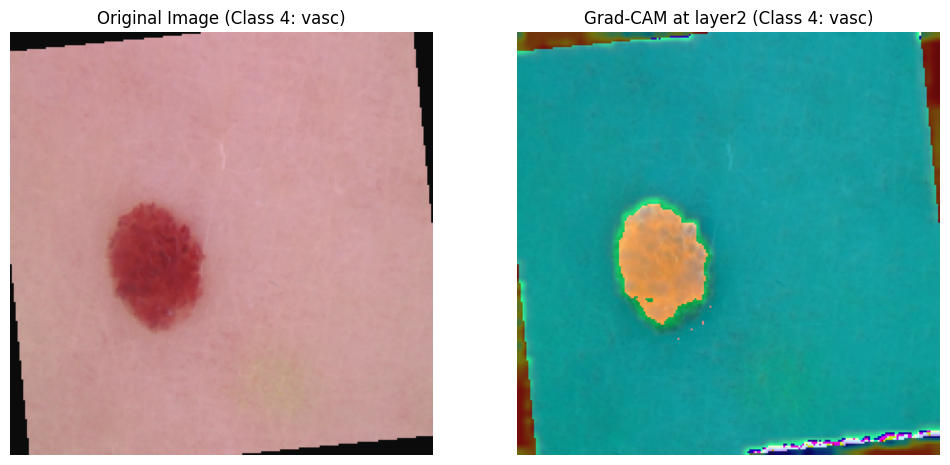

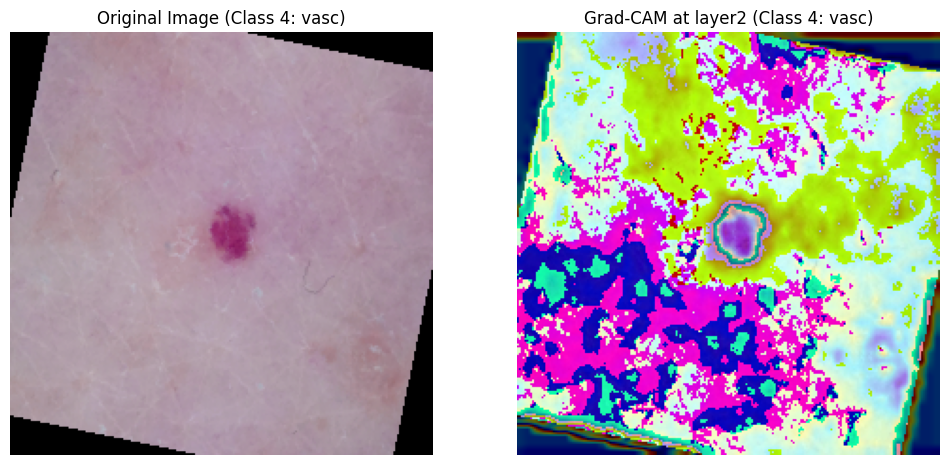


Class 5 - bcc


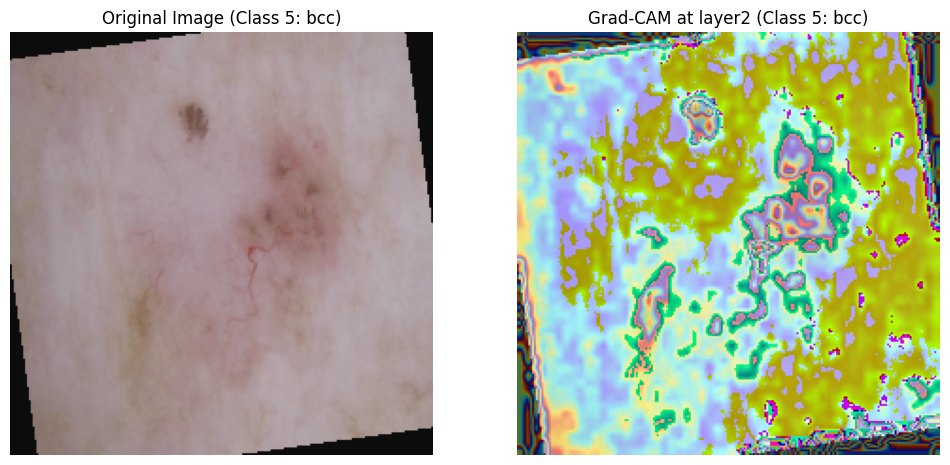

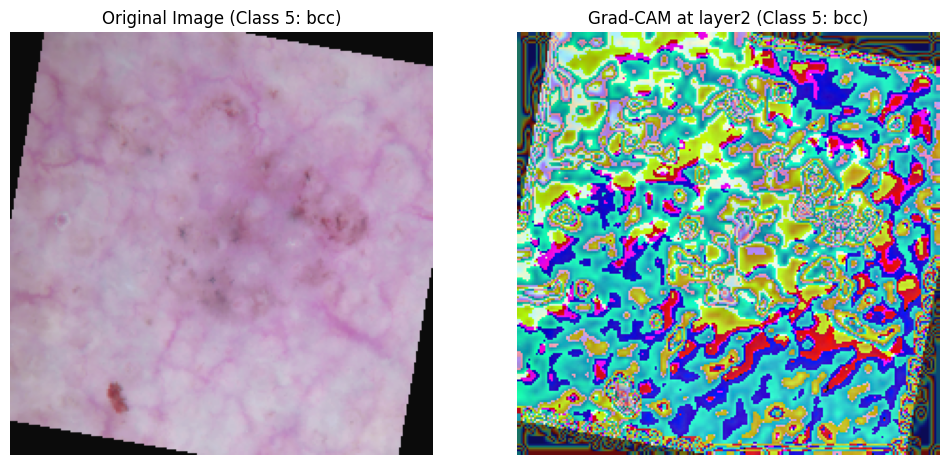


Class 6 - akiec


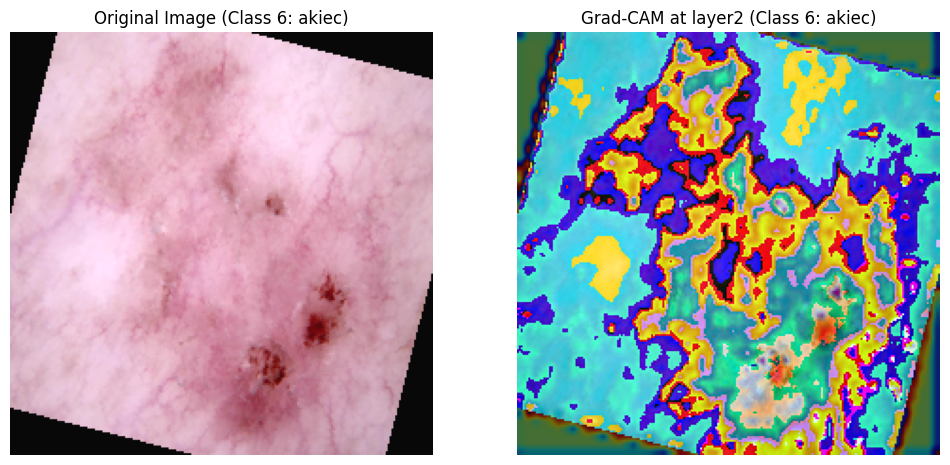

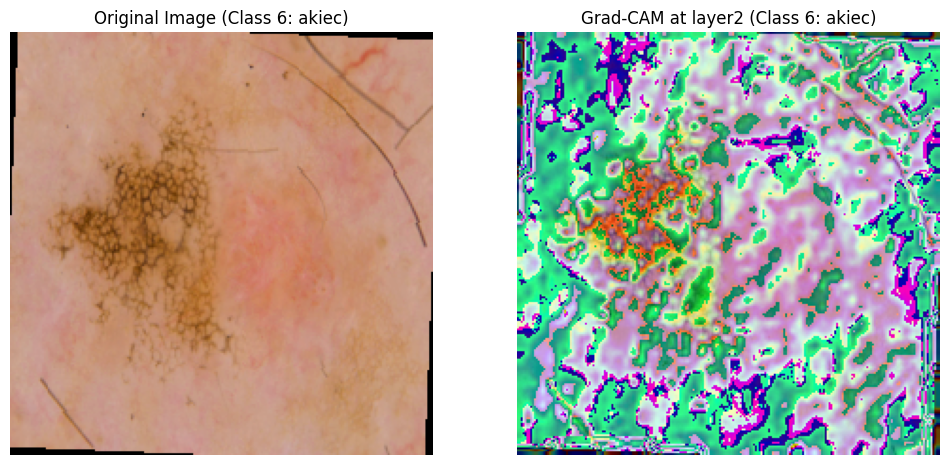

In [64]:
# Loop through each class and apply Grad-CAM on 2 random images at intermediate layer
for target_class in range(7):
    target_images = []
    
    # Collect images of the current target class
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        indices = (labels == target_class).nonzero(as_tuple=True)[0]
        
        for idx in indices:
            target_images.append(images[idx].unsqueeze(0))
    
    if len(target_images) >= 2:
        selected_images = random.sample(target_images, 2)
        class_name = index_to_class[target_class]
        
        print(f"\nClass {target_class} - {class_name}")
        
        for image in selected_images:
            heatmap = grad_cam_layer(CNN_model, image, target_class, "layer2")
            display_grad_cam_layer(image.squeeze(0), heatmap, "layer2", target_class, class_name)
